In [1]:
%reload_ext autoreload
%autoreload 2

In [2]:
import os
import math
import sys
import time
import numpy as np
import pandas as pd
import cv2
import matplotlib.pyplot as plt
from PIL import Image
import imageio

import skimage

import xml.etree.cElementTree as ET

from fastai.vision import *
from fastai.metrics import error_rate

#For the pickle generator
import brambox.boxes as bbb


from utils.yolo_functions import *

In [3]:
# See your current version of python/anaconda
print (sys.version)

3.7.1 | packaged by conda-forge | (default, Mar 13 2019, 13:32:59) [MSC v.1900 64 bit (AMD64)]


# Table of Contents
## [Subimage Generation](#subimage_generation)
## [Create Pickle File](#create_pickle_file)

<a id='subimage_generation'></a>
# Subimage Generation

This function is used to produce the subimages for both YOLO as well as U-Net training


The new goals are:
- Generate subimages for YOLO based on the annotations
- Generate subimages for U-Net
- Generate subimages for U-Net that include all channels
- Add functionality to filter out labelled or unlabelled cells for U-Net training


{'channels': [0, 0, 0], 'subsegmentation': True, 'ground_truths': False, 'ground_truth_suffix': '_seg.png', 'suffix': '.tif', 'subChannels': [0, 1, 5], 'move_to_front': False, 'subimage_height': 370, 'subimage_width': 632, 'black_masks': False}
D:\AI Paper\ExternalDataSet\Reorganized - FluorS4\Annotations
D:\AI Paper\ExternalDataSet\Reorganized - FluorS4
D:\AI Paper\ExternalDataSet\Reorganized - FluorS4\1_1\000hLPS_S1--labels.txt
Exists
D:\AI Paper\ExternalDataSet\Reorganized - FluorS4\1_1\000hLPS_S1.ome.tif
D:\AI Paper\ExternalDataSet\Reorganized - FluorS4 1_1\000hLPS_S1.ome.tif
Segmenting around the ROIs image.... :)
IM D:\AI Paper\ExternalDataSet\Reorganized - FluorS4\JPEGImages\1_1
Shape (512, 512, 3)
   Class      X      Y     W     H   xmin   xmax   ymin   ymax
0    1.0  257.0  350.5  60.0  59.0  227.0  287.0  321.0  380.0
1    1.0  446.0  388.0  60.0  76.0  416.0  476.0  350.0  426.0
2    1.0  308.5  285.5  51.0  53.0  283.0  334.0  259.0  312.0
3    1.0  325.0  178.5  64.0  65.

(512, 512, 3) 416 476 350 426 (76, 60, 3) (7, 76, 60)
(512, 512, 3) 283 334 259 312 (53, 51, 3) (7, 53, 51)
(512, 512, 3) 293 357 146 211 (65, 64, 3) (7, 65, 64)
(512, 512, 3) 114 167 293 361 (68, 53, 3) (7, 68, 53)
(512, 512, 3) 462 512 437 484 (47, 50, 3) (7, 47, 50)
(512, 512, 3) 34 84 222 272 (50, 50, 3) (7, 50, 50)
(512, 512, 3) 112 159 180 222 (42, 47, 3) (7, 42, 47)
(512, 512, 3) 195 238 118 169 (51, 43, 3) (7, 51, 43)
D:\AI Paper\ExternalDataSet\Reorganized - FluorS4\1_1\000hLPS_S2--labels.txt
Exists
D:\AI Paper\ExternalDataSet\Reorganized - FluorS4\1_1\000hLPS_S2.ome.tif
D:\AI Paper\ExternalDataSet\Reorganized - FluorS4 1_1\000hLPS_S2.ome.tif
Segmenting around the ROIs image.... :)
IM D:\AI Paper\ExternalDataSet\Reorganized - FluorS4\JPEGImages\1_1
Shape (512, 512, 3)
   Class      X      Y     W     H   xmin   xmax   ymin   ymax
0    1.0   59.0  230.5  62.0  51.0   28.0   90.0  205.0  256.0
1    1.0   76.5  270.5  49.0  41.0   52.0  101.0  250.0  291.0
2    1.0   40.5  277.5 

11    1.0  264.5  128.0  45.0  44.0  242.0  287.0  106.0  150.0
Stats: X:51, 102, 76 Y:391, 448, 419
Stats: X 0 392 Y 234 512 (278, 392, 3) 5
   Class      X      Y     W     H   xmin   xmax   ymin   ymax  Truncated
0    1.0   76.5  419.5  51.0  57.0   51.0  102.0  157.0  214.0      False
1    1.0  127.0  311.0  48.0  52.0  103.0  151.0   51.0  103.0      False
2    1.0  262.5  440.0  59.0  64.0  233.0  292.0  174.0  238.0      False
3    1.0   30.0  483.0  46.0  46.0    7.0   53.0  226.0  272.0      False
4    1.0  264.5  281.0  59.0  52.0  235.0  294.0   21.0   73.0      False
Object count is 5
Stats: X:103, 151, 127 Y:285, 337, 311
Stats: X 0 443 Y 126 496 (370, 443, 3) 10
    Class      X      Y     W     H   xmin   xmax   ymin   ymax  Truncated
0     1.0   76.5  419.5  51.0  57.0   51.0  102.0  265.0  322.0      False
1     1.0  127.0  311.0  48.0  52.0  103.0  151.0  159.0  211.0      False
2     1.0  262.5  440.0  59.0  64.0  233.0  292.0  282.0  346.0      False
3     1.0   30.

11    1.0  264.5  128.0  45.0  44.0  242.0  287.0  106.0  150.0      False
Object count is 9
D:\AI Paper\ExternalDataSet\Reorganized - FluorS4 1_1\000hLPS_S3.ome.tif
subSegmenting image.... :)
    Class      X      Y     W     H   xmin   xmax   ymin   ymax
0     1.0   76.5  419.5  51.0  57.0   51.0  102.0  391.0  448.0
1     1.0  127.0  311.0  48.0  52.0  103.0  151.0  285.0  337.0
2     1.0  262.5  440.0  59.0  64.0  233.0  292.0  408.0  472.0
3     1.0   30.0  483.0  46.0  46.0    7.0   53.0  460.0  506.0
4     1.0  264.5  281.0  59.0  52.0  235.0  294.0  255.0  307.0
5     1.0  271.0  219.5  50.0  51.0  246.0  296.0  194.0  245.0
6     1.0  166.0  230.0  54.0  48.0  139.0  193.0  206.0  254.0
7     1.0  210.5  195.5  53.0  57.0  184.0  237.0  167.0  224.0
8     1.0  134.5  188.5  53.0  47.0  108.0  161.0  165.0  212.0
9     1.0  219.5   27.0  43.0  40.0  198.0  241.0    7.0   47.0
10    1.0  118.5   47.5  39.0  43.0   99.0  138.0   26.0   69.0
11    1.0  264.5  128.0  45.0  44.0  24

9    1.0   49.0   41.5  46.0  45.0   26.0   72.0   19.0   64.0      False
Object count is 5
D:\AI Paper\ExternalDataSet\Reorganized - FluorS4 1_1\000hLPS_S4.ome.tif
subSegmenting image.... :)
   Class      X      Y     W     H   xmin   xmax   ymin   ymax
0    1.0  142.0  166.0  46.0  56.0  119.0  165.0  138.0  194.0
1    1.0  191.5  155.0  47.0  56.0  168.0  215.0  127.0  183.0
2    1.0  206.5  110.0  47.0  50.0  183.0  230.0   85.0  135.0
3    1.0   50.0  133.0  46.0  56.0   27.0   73.0  105.0  161.0
4    1.0  365.5  255.0  53.0  56.0  339.0  392.0  227.0  283.0
5    1.0  252.0  423.5  50.0  47.0  227.0  277.0  400.0  447.0
6    1.0  423.0  449.5  56.0  45.0  395.0  451.0  427.0  472.0
7    1.0  384.0  400.0  50.0  44.0  359.0  409.0  378.0  422.0
8    1.0   20.0  238.0  40.0  52.0    0.0   40.0  212.0  264.0
9    1.0   49.0   41.5  46.0  45.0   26.0   72.0   19.0   64.0
(512, 512, 3) 119 165 138 194 (56, 46, 3) (7, 56, 46)
(512, 512, 3) 168 215 127 183 (56, 47, 3) (7, 56, 47)
(512, 5

8    1.0  137.5  365.0  55.0  74.0  110.0  165.0  328.0  402.0
(512, 512, 3) 176 219 381 442 (61, 43, 3) (7, 61, 43)
(512, 512, 3) 219 260 375 432 (57, 41, 3) (7, 57, 41)
(512, 512, 3) 253 302 440 485 (45, 49, 3) (7, 45, 49)
(512, 512, 3) 469 512 316 362 (46, 43, 3) (7, 46, 43)
(512, 512, 3) 90 133 57 108 (51, 43, 3) (7, 51, 43)
(512, 512, 3) 16 84 466 512 (46, 68, 3) (7, 46, 68)
(512, 512, 3) 326 406 143 218 (75, 80, 3) (7, 75, 80)
(512, 512, 3) 177 230 305 365 (60, 53, 3) (7, 60, 53)
(512, 512, 3) 110 165 328 402 (74, 55, 3) (7, 74, 55)
D:\AI Paper\ExternalDataSet\Reorganized - FluorS4\1_1\18hLPS_1--labels.txt
Exists
D:\AI Paper\ExternalDataSet\Reorganized - FluorS4\1_1\18hLPS_1.ome.tif
D:\AI Paper\ExternalDataSet\Reorganized - FluorS4 1_1\18hLPS_1.ome.tif
Segmenting around the ROIs image.... :)
IM D:\AI Paper\ExternalDataSet\Reorganized - FluorS4\JPEGImages\1_1
Shape (512, 512, 3)
   Class      X      Y      W      H   xmin   xmax   ymin   ymax
0    1.0  268.0   81.5  100.0   83.0  

4    1.0  342.5  355.0  103.0  102.0  203.0  306.0  297.0  399.0       True
Object count is 4
Stats: X:291, 394, 342 Y:304, 406, 355
Stats: X 26 512 Y 170 512 (342, 486, 3) 6
   Class      X      Y      W      H   xmin   xmax   ymin   ymax  Truncated
0    1.0   73.0  364.5   98.0  103.0   -2.0   96.0  143.0  246.0       True
3    1.0  404.0  192.5   92.0  151.0  332.0  424.0  -53.0   98.0       True
4    1.0  342.5  355.0  103.0  102.0  265.0  368.0  134.0  236.0      False
5    1.0  276.0  466.0   92.0   92.0  204.0  296.0  250.0  342.0      False
6    1.0  172.5  461.5   79.0  101.0  107.0  186.0  241.0  342.0      False
7    1.0  446.5  403.5  101.0  109.0  370.0  471.0  179.0  288.0      False
Object count is 6
Stats: X:230, 322, 276 Y:420, 512, 466
Stats: X 0 512 Y 281 512 (231, 512, 3) 5
   Class      X      Y      W      H   xmin   xmax   ymin   ymax  Truncated
0    1.0   73.0  364.5   98.0  103.0   24.0  122.0   32.0  135.0      False
4    1.0  342.5  355.0  103.0  102.0  291.0

11    1.0   44.5   55.5  89.0  107.0    0.0   89.0    2.0  109.0      False
Object count is 5
Stats: X:221, 313, 267 Y:0, 87, 43
Stats: X 0 512 Y 0 228 (228, 512, 3) 6
    Class      X      Y     W      H   xmin   xmax   ymin   ymax  Truncated
5     1.0  140.5  100.5  75.0   93.0  103.0  178.0   54.0  147.0      False
6     1.0  267.0   43.5  92.0   87.0  221.0  313.0    0.0   87.0      False
7     1.0  277.5  148.5  79.0   89.0  238.0  317.0  104.0  193.0      False
8     1.0  368.5  152.0  65.0  114.0  336.0  401.0   95.0  209.0      False
9     1.0  461.0  138.5  94.0   81.0  414.0  508.0   98.0  179.0      False
11    1.0   44.5   55.5  89.0  107.0    0.0   89.0    2.0  109.0      False
Object count is 6
Stats: X:238, 317, 277 Y:104, 193, 148
Stats: X 0 512 Y 0 333 (333, 512, 3) 7
    Class      X      Y     W      H   xmin   xmax   ymin   ymax  Truncated
0     1.0  177.5  294.0  87.0  100.0  134.0  221.0  244.0  344.0       True
5     1.0  140.5  100.5  75.0   93.0  103.0  178.0  

9    1.0  338.0   47.0   80.0   90.0  298.0  378.0  -32.0   58.0       True
Object count is 9
Stats: X:268, 372, 320 Y:298, 411, 354
Stats: X 4 512 Y 169 512 (343, 508, 3) 7
   Class      X      Y      W      H   xmin   xmax   ymin   ymax  Truncated
0    1.0   50.5  300.5   75.0  109.0    9.0   84.0   77.0  186.0      False
1    1.0   42.0  383.5   84.0   67.0   -4.0   80.0  181.0  248.0       True
3    1.0  232.5  219.0   63.0  114.0  197.0  260.0   -7.0  107.0       True
4    1.0  320.0  354.5  104.0  113.0  264.0  368.0  129.0  242.0      False
5    1.0  402.0  408.0  100.0   96.0  348.0  448.0  191.0  287.0      False
7    1.0  200.5  365.0   83.0   70.0  155.0  238.0  161.0  231.0      False
8    1.0  155.0  321.5  128.0   55.0   87.0  215.0  125.0  180.0      False
Object count is 7
Stats: X:352, 452, 402 Y:360, 456, 408
Stats: X 86 512 Y 223 512 (289, 426, 3) 4
   Class      X      Y      W      H   xmin   xmax   ymin   ymax  Truncated
4    1.0  320.0  354.5  104.0  113.0  182.0

4    1.0  120.0  275.5  78.0  85.0   81.0  159.0  143.0  228.0      False
Object count is 4
Stats: X:411, 477, 444 Y:434, 508, 471
Stats: X 128 512 Y 286 512 (226, 384, 3) 1
   Class      X      Y     W     H   xmin   xmax   ymin   ymax  Truncated
5    1.0  444.0  471.0  66.0  74.0  283.0  349.0  148.0  222.0      False
Object count is 1
D:\AI Paper\ExternalDataSet\Reorganized - FluorS4 1_1\1hLPS_S1.ome.tif
subSegmenting image.... :)
   Class      X      Y     W     H   xmin   xmax   ymin   ymax
0    1.0  234.5  224.0  83.0  90.0  193.0  276.0  179.0  269.0
1    1.0   88.5  172.0  73.0  88.0   52.0  125.0  128.0  216.0
2    1.0  369.5  158.0  67.0  72.0  336.0  403.0  122.0  194.0
3    1.0  436.0  217.5  84.0  77.0  394.0  478.0  179.0  256.0
4    1.0  120.0  275.5  78.0  85.0   81.0  159.0  233.0  318.0
5    1.0  444.0  471.0  66.0  74.0  411.0  477.0  434.0  508.0
(512, 512, 3) 193 276 179 269 (90, 83, 3) (7, 90, 83)
(512, 512, 3) 52 125 128 216 (88, 73, 3) (7, 88, 73)
(512, 512, 3) 

Stats: X:225, 339, 282 Y:208, 284, 246
Stats: X 0 512 Y 61 431 (370, 512, 3) 8
    Class      X      Y      W      H   xmin   xmax   ymin   ymax  Truncated
0     1.0   60.5  141.0   93.0  104.0   14.0  107.0   28.0  132.0      False
2     1.0  271.5  157.5   83.0   75.0  230.0  313.0   59.0  134.0      False
3     1.0   37.0  362.5   56.0  143.0    9.0   65.0  230.0  373.0      False
4     1.0  282.0  246.0  114.0   76.0  225.0  339.0  147.0  223.0      False
8     1.0  392.0  188.5   90.0  117.0  347.0  437.0   69.0  186.0      False
9     1.0  163.5  420.0   85.0  122.0  121.0  206.0  298.0  420.0      False
10    1.0  126.5  250.0   81.0  150.0   86.0  167.0  114.0  264.0      False
11    1.0  468.5  159.5   69.0  109.0  434.0  503.0   44.0  153.0      False
Object count is 8
Stats: X:276, 344, 310 Y:402, 466, 434
Stats: X 0 512 Y 249 512 (263, 512, 3) 6
    Class      X      Y     W      H   xmin   xmax   ymin   ymax  Truncated
3     1.0   37.0  362.5  56.0  143.0    9.0   65.0   4

Object count is 3
Stats: X:78, 186, 132 Y:431, 512, 471
Stats: X 0 448 Y 286 512 (226, 448, 3) 2
   Class      X      Y      W     H  xmin   xmax   ymin   ymax  Truncated
1    1.0  124.0  337.0   94.0  98.0  77.0  171.0    2.0  100.0      False
2    1.0  132.0  471.5  108.0  81.0  78.0  186.0  145.0  226.0      False
Object count is 2
Stats: X:422, 497, 459 Y:83, 224, 153
Stats: X 143 512 Y 0 338 (338, 369, 3) 2
   Class      X      Y     W      H   xmin   xmax   ymin   ymax  Truncated
3    1.0  459.5  153.5  75.0  141.0  279.0  354.0   83.0  224.0      False
4    1.0  401.5  280.0  79.0   66.0  219.0  298.0  247.0  313.0      False
Object count is 2
Stats: X:362, 441, 401 Y:247, 313, 280
Stats: X 85 512 Y 95 465 (370, 427, 3) 3
   Class      X      Y     W      H   xmin   xmax   ymin   ymax  Truncated
1    1.0  124.0  337.0  94.0   98.0   -8.0   86.0  193.0  291.0       True
3    1.0  459.5  153.5  75.0  141.0  337.0  412.0  -12.0  129.0       True
4    1.0  401.5  280.0  79.0   66.0 

11    1.0  240.0  142.0  80.0   82.0  132.0  212.0  101.0  183.0      False
Object count is 7
Stats: X:440, 503, 471 Y:365, 440, 402
Stats: X 155 512 Y 217 512 (295, 357, 3) 5
    Class      X      Y      W      H   xmin   xmax   ymin   ymax  Truncated
1     1.0  239.0  286.0   78.0  110.0   45.0  123.0   14.0  124.0      False
2     1.0  246.0  467.5  104.0   83.0   39.0  143.0  209.0  292.0      False
7     1.0  471.5  402.5   63.0   75.0  285.0  348.0  148.0  223.0      False
9     1.0  159.0  461.0   76.0   76.0  -34.0   42.0  206.0  282.0       True
10    1.0  184.5  367.5   67.0   85.0   -4.0   63.0  108.0  193.0       True
Object count is 5
Stats: X:250, 346, 298 Y:81, 138, 109
Stats: X 0 512 Y 0 294 (294, 512, 3) 7
    Class      X      Y     W      H   xmin   xmax   ymin   ymax  Truncated
0     1.0  153.5  230.0  63.0   90.0  122.0  185.0  185.0  275.0      False
1     1.0  239.0  286.0  78.0  110.0  200.0  278.0  231.0  341.0       True
4     1.0   27.0  108.5  54.0   97.0   

Stats: X 122 512 Y 238 512 (274, 390, 3) 4
   Class      X      Y      W      H   xmin   xmax   ymin   ymax  Truncated
2    1.0  304.0  429.5   90.0  119.0  137.0  227.0  132.0  251.0      False
3    1.0  438.0  423.5   74.0   81.0  279.0  353.0  145.0  226.0      False
4    1.0  469.0  304.5   74.0   97.0  310.0  384.0   18.0  115.0      False
6    1.0  370.0  480.0  112.0   64.0  192.0  304.0  210.0  274.0      False
Object count is 4
Stats: X:432, 506, 469 Y:256, 353, 304
Stats: X 153 512 Y 119 489 (370, 359, 3) 7
   Class      X      Y      W      H   xmin   xmax   ymin   ymax  Truncated
0    1.0  284.0  136.0   74.0  142.0   94.0  168.0  -54.0   88.0       True
2    1.0  304.0  429.5   90.0  119.0  106.0  196.0  251.0  370.0      False
3    1.0  438.0  423.5   74.0   81.0  248.0  322.0  264.0  345.0      False
4    1.0  469.0  304.5   74.0   97.0  279.0  353.0  137.0  234.0      False
6    1.0  370.0  480.0  112.0   64.0  161.0  273.0  329.0  393.0      False
7    1.0  457.0  216.

7    1.0  384.5   38.5   83.0   67.0  201.0  284.0    1.0   68.0      False
Object count is 5
Stats: X:297, 425, 361 Y:223, 309, 266
Stats: X 45 512 Y 81 451 (370, 467, 3) 7
   Class      X      Y      W      H   xmin   xmax   ymin   ymax  Truncated
0    1.0   63.5  223.5   67.0  123.0  -15.0   52.0   81.0  204.0       True
1    1.0  460.0  403.0   64.0  130.0  383.0  447.0  257.0  387.0      False
2    1.0  458.5  189.5   65.0  103.0  381.0  446.0   57.0  160.0      False
3    1.0  361.0  266.0  128.0   86.0  252.0  380.0  142.0  228.0      False
4    1.0  359.5  165.5  111.0   89.0  259.0  370.0   40.0  129.0      False
5    1.0  225.5  377.5   83.0  103.0  139.0  222.0  245.0  348.0      False
6    1.0  143.5   82.0  119.0   76.0   39.0  158.0  -37.0   39.0       True
Object count is 7
Stats: X:304, 415, 359 Y:121, 210, 165
Stats: X 43 512 Y 0 350 (350, 469, 3) 6
   Class      X      Y      W      H   xmin   xmax   ymin   ymax  Truncated
0    1.0   63.5  223.5   67.0  123.0  -13.0  

5    1.0  398.5  294.5  101.0   67.0  268.0  369.0   77.0  144.0      False
Object count is 6
Stats: X:335, 404, 369 Y:145, 224, 184
Stats: X 53 512 Y 0 369 (369, 459, 3) 7
   Class      X      Y      W      H   xmin   xmax   ymin   ymax  Truncated
0    1.0  208.5  312.5  111.0  131.0  100.0  211.0  247.0  378.0       True
1    1.0  298.5  269.5   83.0  129.0  204.0  287.0  205.0  334.0      False
4    1.0  369.5  184.5   69.0   79.0  282.0  351.0  145.0  224.0      False
5    1.0  398.5  294.5  101.0   67.0  295.0  396.0  261.0  328.0      False
6    1.0  135.5   44.0   87.0   50.0   39.0  126.0   19.0   69.0      False
7    1.0  370.0   80.5   84.0  107.0  275.0  359.0   27.0  134.0      False
8    1.0   65.0  244.0   86.0   64.0  -31.0   55.0  212.0  276.0       True
Object count is 7
Stats: X:348, 449, 398 Y:261, 328, 294
Stats: X 82 512 Y 109 479 (370, 430, 3) 6
   Class      X      Y      W      H   xmin   xmax   ymin   ymax  Truncated
0    1.0  208.5  312.5  111.0  131.0   71.0 

8    1.0  415.5   20.5  107.0   41.0  362.0  469.0    0.0   41.0      False
Object count is 4
Stats: X:269, 373, 321 Y:254, 371, 312
Stats: X 5 512 Y 127 497 (370, 507, 3) 6
   Class      X      Y      W      H   xmin   xmax   ymin   ymax  Truncated
0    1.0  392.0  455.5   86.0  103.0  344.0  430.0  277.0  380.0      False
1    1.0  265.0  420.5  164.0   67.0  178.0  342.0  260.0  327.0      False
2    1.0  223.0  486.0  202.0   52.0  117.0  319.0  333.0  385.0      False
3    1.0  138.5  217.5  171.0   71.0   48.0  219.0   55.0  126.0      False
6    1.0  321.0  312.5  104.0  117.0  264.0  368.0  127.0  244.0      False
7    1.0  447.5  342.0  125.0   96.0  380.0  505.0  167.0  263.0      False
Object count is 6
Stats: X:385, 510, 447 Y:294, 390, 342
Stats: X 131 512 Y 157 512 (355, 381, 3) 6
   Class      X      Y      W      H   xmin   xmax   ymin   ymax  Truncated
0    1.0  392.0  455.5   86.0  103.0  218.0  304.0  247.0  350.0      False
1    1.0  265.0  420.5  164.0   67.0   52.

(512, 512, 3) 0 87 73 149 (76, 87, 3) (7, 76, 87)
(512, 512, 3) 169 261 177 246 (69, 92, 3) (7, 69, 92)
D:\AI Paper\ExternalDataSet\Reorganized - FluorS4\1_1\2hLPS_S1--labels.txt
Exists
D:\AI Paper\ExternalDataSet\Reorganized - FluorS4\1_1\2hLPS_S1.ome.tif
D:\AI Paper\ExternalDataSet\Reorganized - FluorS4 1_1\2hLPS_S1.ome.tif
Segmenting around the ROIs image.... :)
IM D:\AI Paper\ExternalDataSet\Reorganized - FluorS4\JPEGImages\1_1
Shape (512, 512, 3)
    Class      X      Y      W      H   xmin   xmax   ymin   ymax
0     1.0  129.5  390.5  121.0   61.0   69.0  190.0  360.0  421.0
1     1.0   99.0  348.0   94.0   90.0   52.0  146.0  303.0  393.0
2     1.0   83.5  140.5  115.0   51.0   26.0  141.0  115.0  166.0
3     1.0  143.0  241.5   98.0   75.0   94.0  192.0  204.0  279.0
4     1.0  387.0  317.0   90.0   62.0  342.0  432.0  286.0  348.0
5     1.0  300.5  356.5   77.0  123.0  262.0  339.0  295.0  418.0
6     1.0  384.0  409.0   84.0   96.0  342.0  426.0  361.0  457.0
7     1.0  186.5

10    1.0  376.5  475.5   97.0   73.0  328.0  425.0  322.0  395.0      False
Object count is 11
Stats: X:47, 109, 78 Y:153, 225, 189
Stats: X 0 394 Y 4 374 (370, 394, 3) 7
   Class      X      Y      W      H   xmin   xmax   ymin   ymax  Truncated
1    1.0   99.0  348.0   94.0   90.0   52.0  146.0  299.0  389.0       True
2    1.0   83.5  140.5  115.0   51.0   26.0  141.0  111.0  162.0      False
3    1.0  143.0  241.5   98.0   75.0   94.0  192.0  200.0  275.0      False
4    1.0  387.0  317.0   90.0   62.0  342.0  432.0  282.0  344.0       True
5    1.0  300.5  356.5   77.0  123.0  262.0  339.0  291.0  414.0       True
7    1.0  186.5  302.0   93.0  100.0  140.0  233.0  248.0  348.0      False
8    1.0   78.0  189.0   62.0   72.0   47.0  109.0  149.0  221.0      False
Object count is 7
Stats: X:286, 345, 315 Y:438, 496, 467
Stats: X 0 512 Y 282 512 (230, 512, 3) 8
    Class      X      Y      W      H   xmin   xmax   ymin   ymax  Truncated
0     1.0  129.5  390.5  121.0   61.0   69.0 

8    1.0  116.5   31.0  115.0   62.0   59.0  174.0    0.0   62.0
Stats: X:128, 223, 175 Y:272, 355, 313
Stats: X 0 491 Y 128 498 (370, 491, 3) 6
   Class      X      Y      W      H   xmin   xmax   ymin   ymax  Truncated
0    1.0  175.5  313.5   95.0   83.0  128.0  223.0  144.0  227.0      False
1    1.0  208.5  185.0   97.0   66.0  160.0  257.0   24.0   90.0      False
2    1.0  453.5  388.5  117.0   65.0  395.0  512.0  228.0  293.0       True
3    1.0  383.5  258.5   97.0   91.0  335.0  432.0   85.0  176.0      False
4    1.0   54.0  317.0   66.0  112.0   21.0   87.0  133.0  245.0      False
6    1.0   74.5  442.5   91.0   79.0   29.0  120.0  275.0  354.0      False
Object count is 6
Stats: X:160, 257, 208 Y:152, 218, 185
Stats: X 0 512 Y 0 370 (370, 512, 3) 7
   Class      X      Y      W      H   xmin   xmax   ymin   ymax  Truncated
0    1.0  175.5  313.5   95.0   83.0  128.0  223.0  272.0  355.0      False
1    1.0  208.5  185.0   97.0   66.0  160.0  257.0  152.0  218.0      False

7    1.0  322.5  286.0   81.0   98.0  282.0  363.0   15.0  113.0      False
Object count is 7
Stats: X:299, 421, 360 Y:377, 504, 440
Stats: X 44 512 Y 255 512 (257, 468, 3) 6
   Class      X      Y      W      H   xmin   xmax   ymin   ymax  Truncated
0    1.0   59.5  457.0  119.0   58.0  -44.0   75.0  173.0  231.0       True
1    1.0  227.0  407.5   92.0  119.0  137.0  229.0   93.0  212.0      False
2    1.0  360.0  440.5  122.0  127.0  255.0  377.0  122.0  249.0      False
3    1.0  236.0  278.5  106.0   67.0  139.0  245.0  -10.0   57.0       True
5    1.0  479.5  278.5   65.0   85.0  403.0  468.0  -19.0   66.0       True
7    1.0  322.5  286.0   81.0   98.0  238.0  319.0  -18.0   80.0       True
Object count is 6
Stats: X:183, 289, 236 Y:245, 312, 278
Stats: X 0 512 Y 93 463 (370, 512, 3) 7
   Class      X      Y      W      H   xmin   xmax   ymin   ymax  Truncated
0    1.0   59.5  457.0  119.0   58.0    0.0  119.0  335.0  393.0      False
1    1.0  227.0  407.5   92.0  119.0  181.0 

9    1.0   32.5  193.0   65.0   92.0    0.0   65.0  147.0  239.0      False
Object count is 7
Stats: X:404, 456, 430 Y:97, 176, 136
Stats: X 114 512 Y 0 321 (321, 398, 3) 3
   Class      X      Y      W      H   xmin   xmax   ymin   ymax  Truncated
4    1.0  286.5   83.0  103.0   84.0  121.0  224.0   41.0  125.0      False
5    1.0  430.0  136.5   52.0   79.0  290.0  342.0   97.0  176.0      False
6    1.0  485.0  203.5   50.0  189.0  346.0  396.0  109.0  298.0      False
Object count is 3
Stats: X:460, 510, 485 Y:109, 298, 203
Stats: X 169 512 Y 18 388 (370, 343, 3) 4
   Class      X      Y      W      H   xmin   xmax   ymin   ymax  Truncated
4    1.0  286.5   83.0  103.0   84.0   66.0  169.0   23.0  107.0      False
5    1.0  430.0  136.5   52.0   79.0  235.0  287.0   79.0  158.0      False
6    1.0  485.0  203.5   50.0  189.0  291.0  341.0   91.0  280.0      False
7    1.0  402.5  361.5   67.0   81.0  200.0  267.0  303.0  384.0      False
Object count is 4
Stats: X:369, 436, 402 Y:3

12    1.0  395.5  212.5  117.0  71.0  206.0  323.0  177.0  248.0      False
Object count is 6
Stats: X:350, 465, 407 Y:6, 97, 51
Stats: X 91 512 Y 0 236 (236, 421, 3) 6
    Class      X      Y      W     H   xmin   xmax   ymin   ymax  Truncated
0     1.0  143.5  162.5   71.0  65.0   17.0   88.0  130.0  195.0      False
1     1.0  260.5  228.5   99.0  59.0  120.0  219.0  199.0  258.0       True
2     1.0  250.5  174.5   87.0  65.0  116.0  203.0  142.0  207.0      False
3     1.0  447.5  119.5  107.0  67.0  303.0  410.0   86.0  153.0      False
4     1.0  407.5   51.5  115.0  91.0  259.0  374.0    6.0   97.0      False
12    1.0  395.5  212.5  117.0  71.0  246.0  363.0  177.0  248.0       True
Object count is 6
Stats: X:446, 512, 479 Y:267, 383, 325
Stats: X 163 512 Y 140 510 (370, 349, 3) 7
    Class      X      Y      W      H   xmin   xmax   ymin   ymax  Truncated
1     1.0  260.5  228.5   99.0   59.0   48.0  147.0   59.0  118.0      False
2     1.0  250.5  174.5   87.0   65.0   44.0 

(512, 512, 3) 108 179 130 195 (65, 71, 3) (7, 65, 71)
(512, 512, 3) 211 310 199 258 (59, 99, 3) (7, 59, 99)
(512, 512, 3) 207 294 142 207 (65, 87, 3) (7, 65, 87)
(512, 512, 3) 394 501 86 153 (67, 107, 3) (7, 67, 107)
(512, 512, 3) 350 465 6 97 (91, 115, 3) (7, 91, 115)
(512, 512, 3) 446 512 267 383 (116, 66, 3) (7, 116, 66)
(512, 512, 3) 330 406 427 499 (72, 76, 3) (7, 72, 76)
(512, 512, 3) 290 363 341 414 (73, 73, 3) (7, 73, 73)
(512, 512, 3) 302 370 284 353 (69, 68, 3) (7, 69, 68)
(512, 512, 3) 115 188 355 450 (95, 73, 3) (7, 95, 73)
(512, 512, 3) 11 109 349 420 (71, 98, 3) (7, 71, 98)
(512, 512, 3) 29 118 250 344 (94, 89, 3) (7, 94, 89)
(512, 512, 3) 337 454 177 248 (71, 117, 3) (7, 71, 117)
D:\AI Paper\ExternalDataSet\Reorganized - FluorS4\1_1\4hLPS_S2--labels.txt
Exists
D:\AI Paper\ExternalDataSet\Reorganized - FluorS4\1_1\4hLPS_S2.ome.tif
D:\AI Paper\ExternalDataSet\Reorganized - FluorS4 1_1\4hLPS_S2.ome.tif
Segmenting around the ROIs image.... :)
IM D:\AI Paper\ExternalDataSet\R

9    1.0  347.5  471.5   69.0   81.0  313.0  382.0  431.0  512.0
(512, 512, 3) 0 114 127 210 (83, 114, 3) (7, 83, 114)
(512, 512, 3) 107 212 51 161 (110, 105, 3) (7, 110, 105)
(512, 512, 3) 256 344 148 218 (70, 88, 3) (7, 70, 88)
(512, 512, 3) 115 261 405 480 (75, 146, 3) (7, 75, 146)
(512, 512, 3) 304 387 243 392 (149, 83, 3) (7, 149, 83)
(512, 512, 3) 182 262 225 343 (118, 80, 3) (7, 118, 80)
(512, 512, 3) 395 505 284 369 (85, 110, 3) (7, 85, 110)
(512, 512, 3) 397 512 373 460 (87, 115, 3) (7, 87, 115)
(512, 512, 3) 341 427 0 81 (81, 86, 3) (7, 81, 86)
(512, 512, 3) 313 382 431 512 (81, 69, 3) (7, 81, 69)
D:\AI Paper\ExternalDataSet\Reorganized - FluorS4\1_1\4hLPS_S3--labels.txt
Exists
D:\AI Paper\ExternalDataSet\Reorganized - FluorS4\1_1\4hLPS_S3.ome.tif
D:\AI Paper\ExternalDataSet\Reorganized - FluorS4 1_1\4hLPS_S3.ome.tif
Segmenting around the ROIs image.... :)
IM D:\AI Paper\ExternalDataSet\Reorganized - FluorS4\JPEGImages\1_1
Shape (512, 512, 3)
   Class      X      Y      W    

9    1.0  317.5  164.5  107.0  101.0  263.0  370.0  114.0  215.0      False
Object count is 8
D:\AI Paper\ExternalDataSet\Reorganized - FluorS4 1_1\4hLPS_S3.ome.tif
subSegmenting image.... :)
   Class      X      Y      W      H   xmin   xmax   ymin   ymax
0    1.0  160.5  244.0   57.0  110.0  132.0  189.0  189.0  299.0
1    1.0  197.0  154.0   78.0  102.0  158.0  236.0  103.0  205.0
2    1.0  236.5  232.5  103.0   73.0  185.0  288.0  196.0  269.0
3    1.0  224.5  307.0   99.0   68.0  175.0  274.0  273.0  341.0
4    1.0  131.0  376.0   78.0   96.0   92.0  170.0  328.0  424.0
5    1.0  187.5  423.5   99.0  123.0  138.0  237.0  362.0  485.0
6    1.0  100.0  168.5   94.0  141.0   53.0  147.0   98.0  239.0
7    1.0   46.0   53.0   88.0  106.0    2.0   90.0    0.0  106.0
8    1.0  414.0   98.5  124.0  137.0  352.0  476.0   30.0  167.0
9    1.0  317.5  164.5  107.0  101.0  264.0  371.0  114.0  215.0
(512, 512, 3) 132 189 189 299 (110, 57, 3) (7, 110, 57)
(512, 512, 3) 158 236 103 205 (102, 7

7    1.0  433.0  432.5   80.0  81.0  276.0  356.0  145.0  226.0      False
Object count is 3
Stats: X:410, 484, 447 Y:192, 279, 235
Stats: X 131 512 Y 50 420 (370, 381, 3) 4
   Class      X      Y     W     H   xmin   xmax   ymin   ymax  Truncated
0    1.0  165.0  302.5  92.0  77.0  -12.0   80.0  214.0  291.0       True
3    1.0  200.5  189.5  71.0  91.0   34.0  105.0   94.0  185.0      False
5    1.0  334.0  193.5  94.0  71.0  156.0  250.0  108.0  179.0      False
8    1.0  447.0  235.5  74.0  87.0  279.0  353.0  142.0  229.0      False
Object count is 4
Stats: X:50, 119, 84 Y:422, 491, 456
Stats: X 0 400 Y 271 512 (241, 400, 3) 5
    Class      X      Y      W      H   xmin   xmax   ymin   ymax  Truncated
0     1.0  165.0  302.5   92.0   77.0  119.0  211.0   -7.0   70.0       True
1     1.0   64.5  291.0   99.0   52.0   15.0  114.0   -6.0   46.0       True
6     1.0  356.0  482.0  104.0   60.0  304.0  408.0  181.0  241.0       True
9     1.0   84.5  456.5   69.0   69.0   50.0  119.0 

7    1.0   82.0   20.5  110.0  41.0   27.0  137.0  -12.0   29.0       True
Object count is 8
Stats: X:0, 78, 39 Y:99, 156, 127
Stats: X 0 355 Y 0 312 (312, 355, 3) 8
   Class      X      Y      W     H   xmin   xmax   ymin   ymax  Truncated
0    1.0  208.0  277.5   68.0  71.0  174.0  242.0  242.0  313.0       True
1    1.0  105.0   72.5   70.0  93.0   70.0  140.0   26.0  119.0      False
2    1.0  272.0  115.0  102.0  56.0  221.0  323.0   87.0  143.0      False
3    1.0  351.5   85.0   71.0  82.0  316.0  387.0   44.0  126.0       True
4    1.0  193.5   33.0   85.0  66.0  151.0  236.0    0.0   66.0      False
5    1.0   41.5  197.5   83.0  77.0    0.0   83.0  159.0  236.0      False
6    1.0   39.0  127.5   78.0  57.0    0.0   78.0   99.0  156.0      False
7    1.0   82.0   20.5  110.0  41.0   27.0  137.0    0.0   41.0      False
Object count is 8
Stats: X:27, 137, 82 Y:0, 41, 20
Stats: X 0 398 Y 0 205 (205, 398, 3) 7
   Class      X      Y      W     H   xmin   xmax   ymin   ymax  Trun

Stats: X:292, 412, 352 Y:168, 296, 232
Stats: X 36 512 Y 47 417 (370, 476, 3) 6
   Class      X      Y      W      H   xmin   xmax   ymin   ymax  Truncated
0    1.0   91.5  335.0  121.0   84.0   -5.0  116.0  246.0  330.0       True
1    1.0  352.0  232.0  120.0  128.0  256.0  376.0  121.0  249.0      False
2    1.0  350.0   99.5   66.0   73.0  281.0  347.0   16.0   89.0      False
3    1.0  415.5   61.5   89.0  121.0  335.0  424.0  -46.0   75.0       True
4    1.0   88.5  220.5  125.0   81.0  -10.0  115.0  133.0  214.0       True
5    1.0  175.0  260.0   98.0  172.0   90.0  188.0  127.0  299.0      False
Object count is 6
Stats: X:317, 383, 350 Y:63, 136, 99
Stats: X 34 512 Y 0 284 (284, 478, 3) 5
   Class      X      Y      W      H   xmin   xmax   ymin   ymax  Truncated
1    1.0  352.0  232.0  120.0  128.0  258.0  378.0  168.0  296.0       True
2    1.0  350.0   99.5   66.0   73.0  283.0  349.0   63.0  136.0      False
3    1.0  415.5   61.5   89.0  121.0  337.0  426.0    1.0  122.0 

8    1.0  105.5  355.0   95.0   76.0   -8.0   87.0  227.0  303.0       True
Object count is 8
Stats: X:415, 512, 463 Y:207, 283, 245
Stats: X 147 512 Y 60 430 (370, 365, 3) 6
   Class      X      Y      W      H   xmin   xmax   ymin   ymax  Truncated
2    1.0  258.5  263.0   85.0   98.0   69.0  154.0  154.0  252.0      False
3    1.0  404.0  362.5   82.0  101.0  216.0  298.0  252.0  353.0      False
4    1.0  464.5  135.0   95.0   96.0  270.0  365.0   27.0  123.0      False
5    1.0  382.0  275.0  126.0   84.0  172.0  298.0  173.0  257.0      False
6    1.0  463.5  245.0   97.0   76.0  268.0  365.0  147.0  223.0      False
7    1.0  298.5  424.0  103.0   78.0  100.0  203.0  325.0  403.0      False
Object count is 6
Stats: X:247, 350, 298 Y:385, 463, 424
Stats: X 0 512 Y 239 512 (273, 512, 3) 7
   Class      X      Y      W      H   xmin   xmax   ymin   ymax  Truncated
2    1.0  258.5  263.0   85.0   98.0  216.0  301.0  -25.0   73.0       True
3    1.0  404.0  362.5   82.0  101.0  363.0

Stats: X 90 512 Y 241 512 (271, 422, 3) 6
   Class      X      Y      W      H   xmin   xmax   ymin   ymax  Truncated
1    1.0  152.5  367.0  123.0   80.0    1.0  124.0   86.0  166.0      False
2    1.0  102.5  440.5   63.0   65.0  -19.0   44.0  167.0  232.0       True
3    1.0  392.0  380.5   80.0   85.0  262.0  342.0   97.0  182.0      False
4    1.0  395.5  485.0   87.0   54.0  262.0  349.0  217.0  271.0      False
5    1.0  326.0  256.5   74.0  117.0  199.0  273.0  -43.0   74.0       True
6    1.0  406.5  426.0  211.0   98.0  211.0  422.0  136.0  234.0      False
Object count is 6
D:\AI Paper\ExternalDataSet\Reorganized - FluorS4 1_1\6hLPS_S4.ome.tif
subSegmenting image.... :)
   Class      X      Y      W      H   xmin   xmax   ymin   ymax
0    1.0   65.0  178.0   90.0  108.0   20.0  110.0  124.0  232.0
1    1.0  152.5  367.0  123.0   80.0   91.0  214.0  327.0  407.0
2    1.0  102.5  440.5   63.0   65.0   71.0  134.0  408.0  473.0
3    1.0  392.0  380.5   80.0   85.0  352.0  432.0

14    1.0  413.0  206.0   92.0   46.0  367.0  459.0  183.0  229.0      False
Object count is 11
Stats: X:336, 405, 370 Y:85, 187, 136
Stats: X 54 512 Y 0 321 (321, 458, 3) 10
    Class      X      Y      W      H   xmin   xmax   ymin   ymax  Truncated
1     1.0  116.0  300.0   74.0  124.0   25.0   99.0  238.0  362.0       True
3     1.0  150.5  177.0   71.0   78.0   61.0  132.0  138.0  216.0      False
4     1.0  227.0  124.5   70.0   77.0  138.0  208.0   86.0  163.0      False
5     1.0  309.5  144.0   87.0   62.0  212.0  299.0  113.0  175.0      False
6     1.0  370.5  136.0   69.0  102.0  282.0  351.0   85.0  187.0      False
7     1.0   77.5   41.0  105.0   82.0  -29.0   76.0    0.0   82.0       True
8     1.0  318.0   41.0   80.0   78.0  224.0  304.0    2.0   80.0      False
9     1.0  479.5  122.0   55.0  114.0  398.0  453.0   65.0  179.0      False
13    1.0   56.5  133.5   83.0   83.0  -39.0   44.0   92.0  175.0       True
14    1.0  413.0  206.0   92.0   46.0  313.0  405.0  18

(512, 512, 3) 392 480 309 423 (114, 88, 3) (7, 114, 88)
(512, 512, 3) 381 471 394 512 (118, 90, 3) (7, 118, 90)
(512, 512, 3) 8 168 343 510 (167, 160, 3) (7, 167, 160)
(512, 512, 3) 15 98 92 175 (83, 83, 3) (7, 83, 83)
(512, 512, 3) 367 459 183 229 (46, 92, 3) (7, 46, 92)
D:\AI Paper\ExternalDataSet\Reorganized - FluorS4\1_1\unst_S1--labels.txt
Exists
D:\AI Paper\ExternalDataSet\Reorganized - FluorS4\1_1\unst_S1.ome.tif
D:\AI Paper\ExternalDataSet\Reorganized - FluorS4 1_1\unst_S1.ome.tif
Segmenting around the ROIs image.... :)
IM D:\AI Paper\ExternalDataSet\Reorganized - FluorS4\JPEGImages\1_1
Shape (512, 512, 3)
    Class      X      Y      W      H   xmin   xmax   ymin   ymax
0     1.0   53.0  210.0   72.0   80.0   17.0   89.0  170.0  250.0
1     1.0  143.5  263.0  117.0  104.0   85.0  202.0  211.0  315.0
2     1.0  293.0  264.5  144.0  127.0  221.0  365.0  201.0  328.0
3     1.0  392.5   79.5   81.0   89.0  352.0  433.0   35.0  124.0
4     1.0  175.5  375.5  109.0   85.0  121.0  23

10    1.0  128.0  421.5   70.0   67.0   -9.0   61.0  159.0  226.0       True
Object count is 8
Stats: X:448, 512, 480 Y:241, 358, 299
Stats: X 164 512 Y 114 484 (370, 348, 3) 6
   Class      X      Y      W      H   xmin   xmax   ymin   ymax  Truncated
2    1.0  293.0  264.5  144.0  127.0   57.0  201.0   87.0  214.0      False
4    1.0  175.5  375.5  109.0   85.0  -43.0   66.0  219.0  304.0       True
6    1.0  276.0  424.5  116.0   69.0   54.0  170.0  276.0  345.0      False
7    1.0  360.0  401.0   72.0   64.0  160.0  232.0  255.0  319.0      False
8    1.0  418.0  414.0   64.0   72.0  222.0  286.0  264.0  336.0      False
9    1.0  480.0  299.5   64.0  117.0  284.0  348.0  127.0  244.0      False
Object count is 6
Stats: X:93, 163, 128 Y:388, 455, 421
Stats: X 0 444 Y 236 512 (276, 444, 3) 8
    Class      X      Y      W      H   xmin   xmax   ymin   ymax  Truncated
1     1.0  143.5  263.0  117.0  104.0   85.0  202.0  -25.0   79.0       True
2     1.0  293.0  264.5  144.0  127.0  2

10    1.0  334.0   72.0  178.0  144.0  245.0  423.0   0.0  144.0      False
Object count is 5
Stats: X:0, 110, 55 Y:23, 143, 83
Stats: X 0 371 Y 0 268 (268, 371, 3) 6
    Class      X      Y      W      H   xmin   xmax   ymin   ymax  Truncated
2     1.0  232.0  260.5   60.0  113.0  202.0  262.0  204.0  317.0       True
3     1.0  200.5  136.5   91.0  103.0  155.0  246.0   85.0  188.0      False
4     1.0  295.5  158.5  103.0  131.0  244.0  347.0   93.0  224.0      False
5     1.0  204.5   50.5   75.0   59.0  167.0  242.0   21.0   80.0      False
6     1.0   55.0   83.0  110.0  120.0    0.0  110.0   23.0  143.0      False
10    1.0  334.0   72.0  178.0  144.0  245.0  423.0    0.0  144.0       True
Object count is 6
Stats: X:263, 369, 316 Y:354, 468, 411
Stats: X 0 512 Y 226 512 (286, 512, 3) 6
   Class      X      Y      W      H   xmin   xmax   ymin   ymax  Truncated
0    1.0  175.5  386.0   89.0  130.0  131.0  220.0   95.0  225.0      False
1    1.0  179.0  282.0   66.0   82.0  146.0 

Stats: X:227, 301, 264 Y:244, 342, 293
Stats: X 0 512 Y 108 478 (370, 512, 3) 7
   Class      X      Y      W      H   xmin   xmax   ymin   ymax  Truncated
0    1.0   50.0  432.5   86.0   87.0    7.0   93.0  281.0  368.0      False
1    1.0  231.5  446.5  173.0  131.0  145.0  318.0  273.0  404.0      False
2    1.0  438.5  446.0   95.0   80.0  391.0  486.0  298.0  378.0      False
3    1.0  489.5  318.5   45.0  113.0  467.0  512.0  154.0  267.0      False
4    1.0  264.0  293.0   74.0   98.0  227.0  301.0  136.0  234.0      False
5    1.0  302.0  253.5   94.0   81.0  255.0  349.0  105.0  186.0      False
6    1.0  148.0  271.5  122.0   63.0   87.0  209.0  132.0  195.0      False
Object count is 7
Stats: X:255, 349, 302 Y:213, 294, 253
Stats: X 0 512 Y 68 438 (370, 512, 3) 5
   Class      X      Y      W      H   xmin   xmax   ymin   ymax  Truncated
0    1.0   50.0  432.5   86.0   87.0    7.0   93.0  321.0  408.0      False
3    1.0  489.5  318.5   45.0  113.0  467.0  512.0  194.0  307.

8    1.0  374.5  324.5  117.0  61.0  277.0  394.0   52.0  113.0      False
Object count is 5
Stats: X:258, 319, 288 Y:325, 378, 351
Stats: X 0 512 Y 166 512 (346, 512, 3) 8
   Class      X      Y      W      H   xmin   xmax   ymin   ymax  Truncated
1    1.0  137.0  188.0   86.0  100.0   94.0  180.0  -28.0   72.0       True
2    1.0  119.5  336.0   99.0   60.0   70.0  169.0  140.0  200.0      False
3    1.0  122.5  387.5   99.0   55.0   73.0  172.0  194.0  249.0      False
4    1.0   39.0  407.0   52.0   84.0   13.0   65.0  199.0  283.0      False
5    1.0  355.0  427.5   84.0   83.0  313.0  397.0  220.0  303.0      False
6    1.0  288.5  351.5   61.0   53.0  258.0  319.0  159.0  212.0      False
7    1.0   22.5  342.0   45.0  120.0    0.0   45.0  116.0  236.0      False
8    1.0  374.5  324.5  117.0   61.0  316.0  433.0  128.0  189.0      False
Object count is 8
Stats: X:0, 45, 22 Y:282, 402, 342
Stats: X 0 338 Y 157 512 (355, 338, 3) 6
   Class      X      Y     W      H   xmin   xmax

7    1.0  299.0   34.0   76.0  68.0  261.0  337.0  -31.0   37.0       True
Object count is 8
Stats: X:279, 338, 308 Y:95, 159, 127
Stats: X 0 512 Y 0 312 (312, 512, 3) 7
   Class      X      Y      W     H   xmin   xmax   ymin   ymax  Truncated
1    1.0  103.5  304.0   91.0  58.0   58.0  149.0  275.0  333.0       True
2    1.0  152.5  266.5   55.0  59.0  125.0  180.0  237.0  296.0      False
3    1.0  160.0  212.5  126.0  65.0   97.0  223.0  180.0  245.0      False
4    1.0  315.5  216.0   63.0  86.0  284.0  347.0  173.0  259.0      False
5    1.0  308.5  127.0   59.0  64.0  279.0  338.0   95.0  159.0      False
6    1.0   46.5  228.0   49.0  62.0   22.0   71.0  197.0  259.0      False
7    1.0  299.0   34.0   76.0  68.0  261.0  337.0    0.0   68.0      False
Object count is 7
Stats: X:22, 71, 46 Y:197, 259, 228
Stats: X 0 362 Y 43 413 (370, 362, 3) 7
   Class      X      Y      W     H   xmin   xmax   ymin   ymax  Truncated
0    1.0  271.5  396.0   65.0  80.0  239.0  304.0  313.0  393

[]

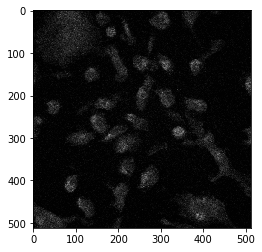

In [15]:
#directory = Path(r'D:\Alex\2019-05-07 ER Segmentation')
#directory = Path(r"D:\[] ML Dataset\Datasets\2019-03-17 AD293 Dataset 24 Hours after Replating Black Cells\2019-03-17 AD293 Dataset 24 Hours after Replating\Cyto-Mem-Mito")
#directory = Path(r"D:\William\2019-06-26 New AD293+INS1E CyMemMito Dataset\03 - INS1E Low Black")
#directory = Path(r"D:\[] ML Dataset\Datasets\YOLO - 2019-03-17 AD293 Dataset 24 Hours after Replating")
#directory = Path(r"D:\[] ML Dataset\Analysis\[Man] 2019-07-25 Cyto and Mito Glucose Dose Response - Copy\01 - CytoMito [Mito Cyto Whole Br]\01 - 1mM (1 hour starved)")
#directory = Path(r"D:\[] ML Dataset\Datasets\2019.03.07 Training dataset INS-1E\YFP mem-Apollo ER-Mitotracker")



#YOLO Training
#directory = Path(r"D:\[] ML Dataset\Datasets\YOLO - 2019.03.07 Training dataset INS-1E - Copy\YFP mem-Apollo Nuc-Mitotracker")
#directory = Path(r"D:\[] ML Dataset\Datasets\YOLO - 2019.03.07 Training dataset INS-1E - Copy\YFP mem-Apollo Cyto-Mitotracker")
#directory = Path(r"D:\[] ML Dataset\Datasets\YOLO - 2019-03-18 AD293 Dataset 48 Hours after Replating\Cy-Mem-Mito")
#directory = Path(r"D:\[] ML Dataset\Datasets\YOLO - 2019-03-17 AD293 Dataset 24 Hours after Replating\Cyto-Mem-Mito")
#directory = Path(r"D:\[] ML Dataset\Datasets\YOLO - 2019-03-17 AD293 Dataset 24 Hours after Replating\Nuc")
#directory = Path(r"D:\[] ML Dataset\Datasets\YOLO - 2019-03-17 AD293 Dataset 24 Hours after Replating\Per-Mem-Mito")


#directory = Path(r"D:\William\Peroxisome Images\2019-06-16")
#directory = Path(r"D:\William\2019-04-12 Representative Singles Different Model\02 - Mito Cyto Hyper [Mito Cyto Whole Br]\01 - 0.1uM H2O2\Baseline_1")
#directory = Path(r"D:\Alex\2020-03-23 Reused AD293 Dataset\Apollo Cyto-YFP mem-Mitotracker")
directory = Path(r"D:\AI Paper\ExternalDataSet\Reorganized - FluorS4\1_1")
#directory = Path(r"D:\[] ML Dataset\Datasets\2019.03.07 Training dataset INS-1E\YFP mem-Apollo ER-Mitotracker\B")

SUBIMAGE_MULTIPLIER = 1 #Determines how much to scale your images.  Choose a value that doesn't crop individual cells
#Choose 2 for AD293 and 1 for INS1E

# Parameters = {"channels":[100,12,13],
#               "subsegmentation": True,
#               "ground_truths": False, 
#               "ground_truth_suffix": ".ome_seg.png",
#               "suffix" : ".ome.tif",
#               "subChannels":[3, 3, 3],
#               "move_to_front": True,  #This will move the subchannels to the front if desired
#               "subimage_height": 370*SUBIMAGE_MULTIPLIER, 
#               "subimage_width": 632*SUBIMAGE_MULTIPLIER, 
#               "black_masks":True}
                
Parameters = {"channels":[0,0,0],
              "subsegmentation": True,
              "ground_truths": False,
              #"ground_truth_suffix": ".ome_seg.png",
              "ground_truth_suffix": "_seg.png",
              "suffix" : ".tif",
              "subChannels":[0, 1, 5],
              "move_to_front": False,  #This will move the subchannels to the front if desired
              "subimage_height": 370*SUBIMAGE_MULTIPLIER, 
              "subimage_width": 632*SUBIMAGE_MULTIPLIER, 
              "black_masks":False}


print(Parameters)



all_files = find_files(directory)
iterate_through_files(all_files, Parameters)

#create_training_pickle(directory)


<a id='create_pickle_file'></a>
# Creating a Pickle for YOLO

This will create a pickle file for use in YOLO training.  Eventually, we will move towards SSD (Single Shot Detection), but YOLO will do for now.  If you select the main folder, all the subfolders will be considered as well

In [51]:
PATH = r"D:\[] ML Dataset\YOLO Training"
PATH = r"D:\AAA\2018-09-16 YOLO Training Set 2\Less Confluent"
PATH = r"D:\William\2019-02-14 YOLO Brightfield"
PATH = r'C:\Users\Rocheleau Analysis\Desktop\Lightnet\examples\yolo-voc\data\VOCdevkit'
PATH = r'D:\[] ML Dataset\YOLO Training\FluorescenceMerge'
PATH = r'C:\Users\Rocheleau Microscope\.fastai\data\Test Set - INS1E'

IMAGE_ID = "JPEGImages"
ANNOTATIONS_ID = "Annotations"
IMG_SUFFIX = ".jpg"
ANNO_SUFFIX = "--labels.xml"
image_directories = find_subdirectories(PATH, IMAGE_ID, directories = [])
x_names, y_names = get_datasets(image_directories, IMG_SUFFIX, ANNO_SUFFIX, IMAGE_ID, ANNOTATIONS_ID)

x_names = np.array(x_names)
y_names = np.array(y_names)


subdirectories = [x.replace(f"{PATH}", "") for x in image_directories]

for sub in subdirectories:
    print (sub)

print(image_directories)
print(subdirectories)
print(len(x_names), len(y_names))

create_training_pickle_from_folders(PATH, subdirectories, ANNOTATIONS_ID, IMAGE_ID)

[]
[]
0 0
	0 xml files
Parsing training annotation files
{}
Generating training annotation file


INFO       [brambox.boxes.annotations.pickle] No 'keep_ignore' kwarg found, defaulting to False.


Done!!


In [20]:
filepath = Path(r"D:\William\2019-03-30 Cytoplasmic Expression from Huntley\2019.03.25 HomoFRET hPKM2 INS-1Es 2PM Venus K305Q sodium butyrate test\1_1_MMStack_Pos0(2).ome.tif")
full_image = imageio.volread(str(filepath))
    

In [22]:
full_image.shape
683.00,1051.00,202.00,190.00

(3, 1480, 2528)

<a id='unet_trainer'></a>
# Unet Network Training Experimentation

The goal of this program is to easily be able to compare the results of different combinations of labels in order to get a mask segmentation of the cells for later use.  It begins with the output of either the YOLO or the SSD network (simulated by manual ROI selection) and then uses the outputs from the SubimageGeneration section combined with manually created ground truths.  A future iteration will involve the ability to combine individual segmentations back into the main image, and then introduce a "Main Cell" vs "Auxillary Cell" class difference and the change the loss function to accomodate it (giving a much higher loss to the classifications of pixels as "Main Cell" when they are actually "Auxillary Cells").  If it works really well but doesn't distinguish well between the main cells and auxillary cells, I can always delete the segmentation for the auxillary cells manually and build my training dataset that way. 



In the open function, there will be a default behaviour for channels under 20 and the custom behaviour for other channels.  That will allow me to introduce interesting features like merging and randomness


The combinations that I'm planning on testing are as follows:
- Three Brightfield Channels (-10, 0, 10), (-7, 0, 7), (-3, 0, 3)
- Two Brightfield Channels and One Fluorescence
- One Brightfield and Two Fluorescence
- Two Brightfield and a merge of all of the fluorescence channels (add a special method to the open files function if the channel is above 16 (ex. 100 means merge all channels) - this will reduce the impact of a specific channel not being labelled


There will also be a randomness componenent added, which I will introduce by overwriting the channels above 100.  The channels will include:
- Two brightfield and one random fluorescence
- One "Below Focus" Image, One in focus, and One "Above Focus"
- Three Randomly Chosen Brightfield Images (sort them afterwards.  Duplicates allowed??? - Harder to implement with the current approach)



Other factors I can train are size

### Links to the relevant cells:
- [Core Helper Functions](#core_helper): Always run these cells before beginning!
- [General Training Functions](#general_training): This section will be your general trainer for a single model
- [Training Tester](#training_tester): This section will allow you to test many different combinations at once
- [Model Tester](#model_tester): Explore Aspects of your trained model (Work in progress...)
- [Transformation Tester](#transformation_tester): This section will allow you to look at the results of various transformations




## Core Helper Functions

<a id='core_helper'></a>

In [4]:
#root_path = Path(r'C:\Users\Rocheleau Analysis\.fastai\data\SegmentationTester')

"""Note:
This code is also found in fastai_helper.py

"""
CURRENT_CHANNELS = [0,3,6]        
SPECIAL_DROPOUT_RATE = 0.0
DROPOUT_RATE = 0.0


def get_y_lambda_function(root_path, mask_folder = 'Mask_Norm', image_folder = 'FullImage'):
    return lambda filename: root_path/mask_folder/filename.relative_to(root_path/image_folder).parent/(filename.name.replace('ome.tif', 'png'))



def load_core_paths(root_path):
    
    mask_path = root_path/"Mask" ; mask_path.mkdir(exist_ok = True)
    seg_path = root_path/"FullImage" ; seg_path.mkdir(exist_ok = True)
    codes_path = root_path/"codes.txt"
    model_path = root_path/'Models' ; model_path.mkdir(exist_ok = True)
    figures_path = root_path/'Figures' ; figures_path.mkdir(exist_ok = True)
    
    #example_image_path = seg_path/r'1_10_MMStack_Pos02.ome.tif'

    codes = np.loadtxt(codes_path, dtype = 'str')
    return (mask_path, seg_path, codes_path, model_path, figures_path, codes)


#Assess the accuracy of the model

def acc_segmentation(input_image, target, void_code = 254):
    target = target.squeeze(1)
    mask = target != void_code
    return (input_image.argmax(dim=1)[mask]==target[mask]).float().mean()



def open_channel(channel, reader, div):
    
    if reader.get_length() == 1:
        import_img = np.asarray(reader.get_data(0))
        x1, x2, x3 = import_img.shape
        #print("Exception...", import_img.shape)
        if x1<5: import_img = import_img[channel, :,:]
        else: import_img = import_img[:,:, channel]
    
    else:
        import_img = np.asarray(reader.get_data(channel))
        
    if div: import_img = np.divide(import_img, np.amax(import_img))
    return (import_img)
    
        
def merge_channels(channels, reader, div, dropout_rate = 0.0):
    num_channels = len(channels)
    merged_image = np.zeros(reader.get_data(0).shape)
    for ch in channels:
        if np.random.uniform() > dropout_rate:
            temp_channel = open_channel(ch, reader, div)
            merged_image += temp_channel/np.amax(temp_channel)/num_channels
            #print ("Kept channel", ch)
        #else: print ("Dropped channel", ch)
    return (merged_image)


def get_channel(channel, reader, div, dropout_chance = DROPOUT_RATE):
    if channel<20:
        return (open_channel(channel, reader, div))
    
    elif channel == 100: #Merge first of all Fluorescence Channels
        return (merge_channels([0,3,6], reader, div))
        
    elif channel == 101: #Random Lower BR Channel
        channel =  (np.random.randint(9, 12))
        return (open_channel(channel, reader, div))
    
    
    elif channel == 102: #Random Upper BR Channel
        channel =  (np.random.randint(13, 16))
        return (open_channel(channel, reader, div))
    
    elif channel == 103: #Random BR Channel
        channel =  (np.random.randint(9, 16))
        return (open_channel(channel, reader, div))
    
    elif channel == 104: #Merge all BR Channels
        return (merge_channels(range(9, 16), reader, div))
    
    
    elif channel == 107:  #Any random channels
        channel =  (np.random.randint(0, 16))
        return (open_channel(channel, reader, div))
    
    
    elif channel == 110: #Black Channel
        return(np.zeros(reader.get_data(0).shape))
    
    elif channel == 111: #Dropout Merge of Fluorescent Channels
        return (merge_channels([0,3,6], reader, div, SPECIAL_DROPOUT_RATE))
    
    
    elif channel >= 200:     #Lots of room for errors with this...  Will default to the 200 code if it pases the dropout test
        if np.random.uniform()>dropout_chance: 
            #print ("Defaulting to", channel-200)
            return (get_channel(channel - 200, reader, div))
        else:
            return (get_channel(110, reader, div))
        
        

def open_image_array(fn:PathOrStr, div:bool=True, convert_mode:str='RGB', cls:type=Image,
        after_open:Callable=None)->Image:

    
    #Assumes an input of (h, w, c)
    
    a = np.asarray(fn)
    if a.ndim==2 : a = np.expand_dims(a,2)
    #a = np.moveaxis(a, -1, 0)  #move last axis (the number of channels) to the front
    if div: a = np.divide(a, np.amax(a))
    a =  torch.from_numpy( a.astype(np.float32, copy=False) )

    #if after_open: x = after_open(x)
    x = a
    return cls(x)


        
def open_image_2(fn:PathOrStr, div:bool=True, convert_mode:str='RGB', cls:type=Image,
        after_open:Callable=None)->Image:
    "Return `Image` object created from image in file `fn`."
    """with warnings.catch_warnings():
        warnings.simplefilter("ignore", UserWarning) # EXIF warning from TiffPlugin
        x = PIL.Image.open(fn).convert(convert_mode)
    
    """
    #print(fn)
    
    ch = CURRENT_CHANNELS  #This is sloppy coding.  I Should have an channel input, but this is only used for testing purposes
    dropout_rate = DROPOUT_RATE
    
    #print (ch)
    reader = imageio.get_reader(str(fn))
    
    image = []

    for channel in ch:

        import_img = get_channel(channel, reader, div, dropout_rate)
        image.append(import_img)

    image_together = np.dstack(image)
    
    
    a = np.asarray(image)
    if a.ndim==2 : a = np.expand_dims(a,2)
    a =  torch.from_numpy( a.astype(np.float32, copy=False) )
    #if after_open: x = after_open(x)
    x = a
    #print(type(cls(x))) 
    return cls(x)


class SegMultiImageList(SegmentationItemList):
    def open(self, fn):
        "Open image in `fn`, subclass and overwrite for custom behavior."
        return open_image_2(fn, convert_mode=self.convert_mode, after_open=self.after_open)





<a id='general_training'></a>
## General Training Functions

Note, this training functions will assume you have the following folders: <br>
1. A 'FullImage' folder containing your .ome.tif image files<br>
2. A 'Mask_Norm' folder containing your .png mask ground truths<br>  If you have not created this folder, [use the function located here](#mask_normalization)


To accomodate a more detailled analysis of the training, you can set return_cache to true to also return more information about the training run



In [5]:
def unet_trainer_program (root_path, export_name = 'Export.pkl', lr = 1e-4, 
                          size = 400, bs = 4, tfms = get_transforms(), 
                          model = models.resnet34, 
                          reuse_old_model = False, old_model_name = 'Starter',
                          train_mode = True, wd = 1e-2, return_cache = False):
    
    
    mask_path = root_path/"Mask_Norm" ; mask_path.mkdir(exist_ok = True)
    seg_path = root_path/"FullImage" ; #seg_path.mkdir(exist_ok = True)
    codes_path = root_path/"codes.txt"
    model_path = root_path/'Models' ; model_path.mkdir(exist_ok = True)
    figures_path = root_path/'Figures' ; figures_path.mkdir(exist_ok = True)

    codes = np.loadtxt(codes_path, dtype = 'str')
    name2id = {code:number for number,code in enumerate(codes)}
    void_code = name2id['Void']
        
    #tfms = get_transforms(flip_vert = True)
    get_mask_func = get_y_lambda_function(root_path)

    
    
    #Padding Mode is an important parameter to check later!!  Mayeb set to zeros
    data = (SegMultiImageList
                 .from_folder(seg_path, recurse = True)
                 .split_by_rand_pct()
                 .label_from_func (get_mask_func, classes = codes)
                 .transform(tfms = tfms, size = size, tfm_y = True, padding_mode = 'border')
                 .databunch(bs = bs, num_workers = 0))
    


    
    
    
    learn = unet_learner(data, model, wd = wd, metrics = [acc_segmentation])
    #learn.save(model_path/'Starter')
    if reuse_old_model:  learn.load(old_model_name)
    
    
    
    cache = initialize_cache() #This will store information about the training, like the loss 
    
    if train_mode:
        learn.fit_one_cycle(5)
        cache = update_cache(learn, cache)
        learn.unfreeze()
        learn.fit_one_cycle(100, slice(lr))
        cache = update_cache(learn, cache)


        learn.export(model_path/export_name)


        #output_results(figures_path, learn)
        output_cache_results(figures_path, cache)
    
    if return_cache: return learn, cache
    else: return learn

    
    
    
    
    
    
    
def initialize_cache():
    #Filler function for now
    return {}

def update_cache(learn, cache):
    
    items = [('Loss', np.asarray(learn.recorder.losses)),
             ('Accuracy', np.asarray(learn.recorder.metrics))
            ]
    for name, values in items:
        if name in cache: cache[name] = np.concatenate((cache[name], values))
        else: cache[name] = values
    
    return cache
    
    

def output_cache_results(output_path, cache):
    loss_results = cache['Loss']
    accuracy_results = cache['Accuracy']
    
    
    for name, results in [("Loss Results", loss_results),("Accuracy Results",accuracy_results)]:
        plt.plot(results)
        plt.title(name)
        plt.xlabel("Epochs")  #Note, the loss outputs aren't for epochs...
        plt.savefig(output_path/f"{name}-cache.png")
        plt.close()
        
        np.savetxt(output_path/f"{name}-cache.txt", results)
    return None



#This function is now obsolete
def output_results(output_path, learn):
    loss_results = np.asarray(learn.recorder.losses)
    accuracy_results = np.asarray(learn.recorder.metrics)
    
    
    for name, results in [("Loss Results", loss_results),("Accuracy Results",accuracy_results)]:
        plt.plot(results)
        plt.title(name)
        plt.xlabel("Epochs")  #Note, the loss outputs aren't for epochs...
        plt.savefig(output_path/f"{name}.png")
        plt.close()
        
        np.savetxt(output_path/f"{name}.txt", results)
        
    return None



## Start Here...

Follow the steps outlined in the cell below

### Common Route (For both the single and multi)

In [6]:
"""Step 1: Choose the root path to your training folder"""
root_path = Path(r'C:\Users\William\.fastai\data\Organelle Trainers\Whole Cell Trainer')
#root_path = Path(r"C:\Users\William\.fastai\data\Mask Trainer")
root_path = Path(r'C:\Users\Rocheleau Microscope\.fastai\data\Mask Trainer')


"""Step 2: Choose the channels that you want to use for segmenting.  Remember that there are special codes:
100: #Merge All Fluorescence Channels
101: #Random Lower BR Channel
102: #Random Upper BR Channel
103: #Random BR Channel
104: #Merge all BR Channels
107: #Any random channels
110: #Black Channel
111: #Drouput merge

"""
CURRENT_CHANNELS = [3,110,110]
DROPOUT_RATE = 0.0
SPECIAL_DROPOUT_RATE = 0.0

"""Step 3: Change any of the default parameters:"""
lr = 1e-4                   #Learning Rate
bs = 4                      #Batch Size
size = 400                  #Size of the network (images reshaped to (sz, sz))
model = models.resnet34     #Model 
export_name = 'Export.pkl'  #Export Name
wd = 1e-2

train_mode = True           #Set this to false if you just want to explore the model (ex. predictions)
reuse_old_model = False      #Set this to true if you want to start your model off using saved weights
old_model_name = 'Starter'



"""Step 4: Choose your data augmentation parameters.  Uncomment any transform that you don't want to use"""

"""tfms = get_transforms(flip_vert = True, 
                      max_rotate = 180, #Affects Rotate
                      max_zoom = 1.5,
                      max_lighting = 0.9, #Affects Brightness and Contrast
                      #max_warp = 1.0, #Affects Symmetric Warp
                      #p_affine = 1.0, 
                      #p_lighting = 1.0
                     )

"""


custom_tfms = [pad(padding=(4), mode = 'zeros', p=0.5),
               pad(padding=(2), mode = 'zeros', p=0.5),  #Adding both has an additive effect (0-6 padding)
               rand_crop(padding_mode = 'zeros', p=1.0),
               rotate(degrees=(-180,180), p=1.),
               brightness(change = (0.3,0.65), p = 1.0),
               contrast(scale = (0.75, 1.25), p = 1.0),
               symmetric_warp(magnitude = (0,0.5), p = 1.0),
               #rand_zoom(scale = (1.0, 1.1), p=1.0),
               dihedral(p = 1.0),
              ]

tfms = (custom_tfms, [crop_pad()])





### End of Common Route
From here, either jump to the:
- [Single Trainer](#single_trainer)
- [Multimodel Trainer](#training_tester)

<a id='single_trainer'></a>
### Single Trainer

In [47]:
"""Step 5: The trainer runs for you using your chosen parameters"""
learner, cache = unet_trainer_program(root_path, 
                                      tfms = tfms, 
                                      bs = bs, 
                                      lr = lr, 
                                      size = size, 
                                      model = model,
                                      train_mode = train_mode,  
                                      return_cache = True, #This will return learn, cache instead of just learn
                                      reuse_old_model = reuse_old_model,
                                      old_model_name = old_model_name
                                       #This will load the weights from 
                                     )


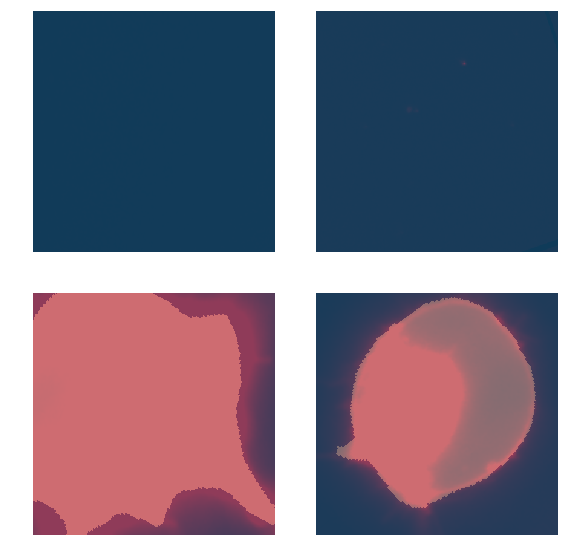

In [50]:
learner.data.show_batch(9)

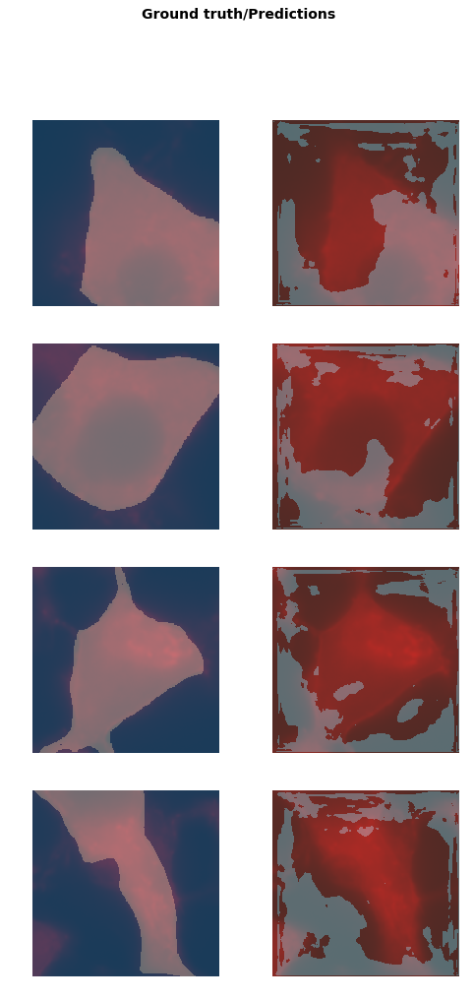

In [38]:
learner.show_results(5, 5)

<a id='training_tester'></a>
# Multimodel Trainer (For comparing models)

There are many things that you can compare including:
- Dropout Rate
- Channels used
- Special Drouput (Merge)
- Model used
- Image size


In [7]:
""" 

The format for the trainer is:
(Name, Channel Codes, Dropout_rate, Special_Dropout_Rate)

Name - String describing the current training

ex. ('Fluorescence', [0,3,6], 0.3, 0.7)



#Note dropout will only be performed if you add 200 to the channel
#Special Dropout will only be performed if you choose a special merge (ex. code 111 or 311 for the dropout option)


100: #Merge All Fluorescence Channels
101: #Random Lower BR Channel
102: #Random Upper BR Channel
103: #Random BR Channel
104: #Merge all BR Channels
107: #Any random channels
110: #Black Channel
111: #Drouput merge




"""

" \n\nThe format for the trainer is:\n(Name, Channel Codes, Dropout_rate, Special_Dropout_Rate)\n\nName - String describing the current training\n\nex. ('Fluorescence', [0,3,6], 0.3, 0.7)\n\n\n\n#Note dropout will only be performed if you add 200 to the channel\n#Special Dropout will only be performed if you choose a special merge (ex. code 111 or 311 for the dropout option)\n\n\n100: #Merge All Fluorescence Channels\n101: #Random Lower BR Channel\n102: #Random Upper BR Channel\n103: #Random BR Channel\n104: #Merge all BR Channels\n107: #Any random channels\n110: #Black Channel\n111: #Drouput merge\n\n\n\n\n"

In [8]:
"""Template 1: Each channel has its own parameters"""


TRAINING_CHANNELS = [('Fluorescence', [0,3,6], 0, 0), #fluorescence
                     ('Low Brightfield' , [11,12,13], 0, 0), #Low OoF Brightfield
                     ('Med Brightfield' ,[10,12,14], 0, 0), #Med OoF Brightfield
                     ('High Brightfield' , [9,12,15], 0, 0), #High OoF Brightfield
                     ('Merge and Brightfield' , [100, 12, 13], 0, 0), #Merge and Brightfield
                     ('All Black', [110, 110, 110], 0, 0), #All Black
                     ('All Random' , [107, 107, 107] ,0, 0), #All Random
                     ('All Infocus BR' , [12, 12, 12], 0, 0), #Only In-focus Brightfield
                     ('RND Brightfield Above and Below', [101, 12, 102],0,0),
                     ('Dropout Fluorescence Merge and Brightfield', [111, 12, 13], 0, 0),
                     ('Dropout Fluorescence', [200,203,206], 0, 0)
                    ]

In [45]:
""" Template 2: List Comprehension to generate dropout for fluorescence"""

dropout_array = np.arange(0,1.1,0.1)

TRAINING_CHANNELS = [('Dropout Fluorescence', [200,203,206], x, 0) for x in dropout_array] + [('All Black', [110, 110, 110], 0, 0)]



In [7]:
""" Template 3: List comprehension for special dropout"""

special_dropout_array = np.arange(0,1.1,0.1)

TRAINING_CHANNELS = [('Dropout Fluorescence Merge and Brightfield', 
                      [111, 12, 13], 0, x) for x in special_dropout_array] + [('All Black', [110, 110, 110], 0, 0)]


In [7]:
""" Figure 2a Template """

TRAINING_CHANNELS = [('Fluorescence', [0,3,6], 0, 0), #fluorescence
                     ('Channel 1', [0,110,110], 0, 0), #fluorescence
                     ('Channel 2', [110,3,110], 0, 0), #fluorescence
                     ('Channel 3', [110,110,6], 0, 0), #fluorescence
                     ('All Random' , [107, 107, 107] ,0, 0), #All Random
                     ('All Infocus BR' , [12, 12, 12], 0, 0), #Only In-focus Brightfield
                     ('All Black', [110, 110, 110], 0, 0), #All Black
                    ]

In [7]:
""" Figure 3a Template """

TRAINING_CHANNELS = [('All Infocus BR' , [12, 12, 12], 0, 0), # Only In-focus Brightfield
                     ('Low OoF' , [11, 12, 13], 0, 0), # Low OoF
                     ('Med OoF' , [10, 12, 14], 0, 0), # Medium OoF
                     ('High OoF' , [9, 12, 15], 0, 0), # High OoF
                     ('RND Brightfield Above and Below', [101, 12, 102],0,0),
                     ('All Black', [110, 110, 110], 0, 0), #All Black
                    ]

In [9]:
""" Figure 4 Template """
dropout = 0.5

TRAINING_CHANNELS = [('RND Brightfield Above and Below', [101, 12, 102],0,0),
                     ('Merge and Brightfield' , [100, 12, 102], 0, dropout), #Merge and Brightfield
                     ('Ch1 and Brightfield' , [200, 12, 102], dropout, 0), #Merge and Brightfield
                     ('Ch2 and Brightfield' , [203, 12, 102], dropout, 0), #Merge and Brightfield
                     ('Ch3 and Brightfield' , [206, 12, 102], dropout, 0), #Merge and Brightfield
                     ('Fluorescence', [200,203,206], dropout, 0), #fluorescence                     
                     ('All Black', [110, 110, 110], 0, 0), #All Black
                    ]

In [10]:
#Choose your root path here...
figures_path = root_path/'Figures'; figures_path.mkdir(exist_ok = True)


def output_dataframe (results, col_labels, output_path = 'test.csv'):
    results_df= pd.DataFrame(np.asarray(results).squeeze().T, columns = col_labels)
    results_df.to_csv(output_path)
    return results_df




loss_results = []
acc_results = []
final_acc = []
for name, training_channels, dropout, spec_dropout in TRAINING_CHANNELS:
    """Note: Special Dropout refers to the rate at which channels are dropped during the merging process
       Dropout rate refers to the rate at which  
        
    """

    #Note, these must be set so that they can interact properly with the trainer.  It would be better to pass them in
    CURRENT_CHANNELS = training_channels
    DROPOUT_RATE = dropout
    SPECIAL_DROPOUT_RATE = spec_dropout

    learner, cache = unet_trainer_program(root_path, 
                                      export_name = f'{name}.pkl',
                                      tfms = tfms, 
                                      bs = bs, 
                                      lr = lr, 
                                      size = size, 
                                      model = model,
                                      train_mode = True,  #Keep this as true since we are training
                                      return_cache = True,#Keep this as true
                                      #reuse_old_model = reuse_old_model,
                                      #old_model_name = old_model_name
                                     )

    
    loss_r = cache['Loss'] #np.asarray(learn.recorder.losses)
    acc_r = cache['Accuracy'] #np.asarray(learn.recorder.metrics)
    final_a = acc_r[-5:].mean()
    
    
    loss_results.append(loss_r)
    acc_results.append(acc_r)
    final_acc.append(final_a)
    
    #learn.export(model_path/f'{name}.pkl')
    
    
for (name, tc, _, _), accs in zip(TRAINING_CHANNELS, final_acc):
    print (name, tc, accs)
    
training_labels = [f"{x}, Dr{y}, SDr{z}" for (x, _, y, z) in TRAINING_CHANNELS]
training_labels


output_dataframe(acc_results, training_labels, figures_path/'acc_results.csv')
output_dataframe(loss_results, training_labels, figures_path/'loss_results.csv')

epoch,train_loss,valid_loss,acc_segmentation,time
0,0.837522,0.682218,0.709706,00:34
1,0.654017,0.410659,0.808144,00:22
2,0.526013,0.304652,0.859936,00:22
3,0.454778,0.299570,0.867474,00:22
4,0.370403,0.294708,0.874457,00:22


epoch,train_loss,valid_loss,acc_segmentation,time


RuntimeError: CUDA out of memory. Tried to allocate 241.75 MiB (GPU 0; 12.00 GiB total capacity; 3.92 GiB already allocated; 123.71 MiB free; 729.71 MiB cached)

In [ ]:
#torch.cuda.empty_cache(); del seg_data, seg_learn; torch.cuda.empty_cache()

In [ ]:
#Accuracy Plot
training_labels = [f"{x}, Dr{y}, SDr{z}" for (x, _, y, z) in TRAINING_CHANNELS]
training_labels


num_labels = len(final_acc)

plt.figure(figsize = (10,5))
plt.bar(range(num_labels), final_acc)
plt.xticks(range(num_labels), training_labels, fontsize = 2)
plt.ylabel("Accuracy", fontsize = 15)
plt.xlabel ("Training Channels", fontsize = 15)
plt.title("Final Training Accuracy", fontsize = 15)
plt.savefig(figures_path/'accuracy.eps', format = 'eps' )
plt.savefig(figures_path/'accuracy.png', format = 'png' )



In [ ]:
rolling_window = 10
plt.figure(figsize = (10,10))
plt.title("Training")
for i, label in enumerate(training_labels):
    if rolling_window:
        plt.plot(pd.Series(acc_results[i].squeeze()).rolling(rolling_window).mean(), label = label)
    else: plt.plot(acc_results[i], label = label)
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.legend(loc = 0)
plt.savefig(figures_path/'train_accuracy.eps', format = 'eps' )
plt.savefig(figures_path/'train_accuracy.png', format = 'png' )

<a id='transformation_tester'></a>
## Test your transformations

- Step 1: Choose the example image and set example_image_path to its path

- Step 2: Set your transformation parameters in either the relevant transformation explorer

- Step 3: Run that cell

In [11]:
root_path = Path(r"C:\Users\Rocheleau Microscope\.fastai\data\Mask Trainer")
root_path = Path(r'C:\Users\William\.fastai\data\Mask Trainer')

example_image_path = root_path/r'FullImage'/'20090307CyMemMito'/r'1_5_MMStack_Pos00.ome.tif'


def get_example_image():
    return open_image_2(example_image_path)

def get_img(): return open_image_2(example_image_path)

def plots_f(rows, cols, width, height, **kwargs):
    [get_example_image().apply_tfms(custom_tfms, padding_mode = 'zeros', **kwargs).show(ax=ax) for i,ax in enumerate(plt.subplots(
        rows,cols,figsize=(width,height))[1].flatten())]
    
def one_hot_encoding_array (x, scale=1):
    array = torch.tensor(np.zeros(8))
    array[x] = scale
    return array

### Transformation Explorer (Apply All)

This cell will apply your transformations to your example image (found in example_image_path)

In [13]:
CURRENT_CHANNELS = [11,12,13]
custom_tfms = [pad(padding=(4), mode = 'zeros', p=0.5),
               pad(padding=(2), mode = 'zeros', p=0.5),
               rand_crop(padding_mode = 'zeros', p=1.0),
               rotate(degrees=(-180,180), p=1.),
               brightness(change = (0.3,0.65), p = 1.0),
               contrast(scale = (0.75, 1.25), p = 1.0),
                   #jitter(magnitude = 1.0, p = 1.0),
               symmetric_warp(magnitude = (0,0.5), p = 1.0),
               #rand_zoom(scale = (1.0, 1.1), p=1.0),
               dihedral(p = 1.0),
               
               #add skew
              ]




plots_f(4,4,200,200)


### Transformation Explorer (Apply Individually)

Step 1: Run the cell for the transformations that you wake

In [20]:
""" Template 1: Default Transforms from get_transforms() """

do_flip=True
flip_vert=False
max_rotate=10.
max_zoom=1.1
max_lighting=0.2
max_warp=0.2
p_affine=0.75
p_lighting=0.75

ntests = 10
DIRECT_TFMS = {("Brightness", brightness): [{'change': x, 'p':p_lighting} for x in np.linspace(0.4,0.6,num=ntests)], 
               ("Contrast", contrast):[{'scale': x, 'p':p_lighting} for x in np.linspace(1-max_lighting,1/(1-max_lighting),num = ntests)], 
#               ('Crop', crop):[{'size':(sz, sz), 'row_pct':0.9, 'col_pct':0.9} for sz in range(200,500,50)],
#               ('Crop Pad', crop_pad):[{'size':sz, 'padding_mode':'zeros'} for sz in range (200, 700, 50)],
#               ('Dihedral', dihedral):[{'k':x} for x in range(8)],
               ('Flip LR', flip_lr):[{}],
#               ('Jitter', jitter):[{'magnitude':x} for x in np.linspace(0,0.5, ntests)],
#               ('Pad', pad):[{'padding':x, 'mode':'border'} for x in range(0,40,4)],
#               ('Perspective Warp Direction', perspective_warp):[{'magnitude':one_hot_encoding_array(x, 1)} 
#                                                                 for x in range(8)],
#               ('Perspective Warp Magnitude', perspective_warp):[{'magnitude':one_hot_encoding_array(0, x)} 
#                                                                 for x in np.linspace(0,1,ntests)],
               ('Rotate', rotate):[{'degrees':x} for x in np.linspace(-max_rotate,max_rotate, ntests)],
#               ('Skew Direction', skew): [{'direction':x, 'magnitude':2} for x in range(8)],
#               ('Skew Magnitude', skew): [{'direction':0, 'magnitude':x} for x in np.linspace(0,10,ntests)],
               ('Symmetric Warp', symmetric_warp): [{'magnitude':(x,0, 0, 0), 'p':p_affine} for x in np.linspace(-max_warp,max_warp, ntests)],
#                ('Symmetric Warp All', symmetric_warp): [{'magnitude':(x,x,x,x)} for x in np.linspace(0,1, ntests)],
               
              
             }


In [14]:
""" Template 2: Custom Transforms """

ntests = 10
DIRECT_TFMS = {("Brightness", brightness): [{'change': x} for x in np.linspace(0,1,num=ntests)], 
              ("Contrast", contrast):[{'scale': x} for x in np.linspace(0,1,num = ntests)], 
              ('Crop', crop):[{'size':(sz, sz), 'row_pct':0.9, 'col_pct':0.9} for sz in range(200,500,50)],
              ('Crop Pad', crop_pad):[{'size':sz, 'padding_mode':'zeros'} for sz in range (200, 700, 50)],
              ('Dihedral', dihedral):[{'k':x} for x in range(8)],
              ('Flip LR', flip_lr):[{}],
              ('Jitter', jitter):[{'magnitude':x} for x in np.linspace(0,0.5, ntests)],
              ('Pad', pad):[{'padding':x, 'mode':'border'} for x in range(0,40,4)],
              ('Perspective Warp Direction', perspective_warp):[{'magnitude':one_hot_encoding_array(x, 1)} 
                                                                for x in range(8)],
              ('Perspective Warp Magnitude', perspective_warp):[{'magnitude':one_hot_encoding_array(0, x)} 
                                                                for x in np.linspace(0,1,ntests)],
              ('Rotate', rotate):[{'degrees':x} for x in np.linspace(0,360, ntests)],
              ('Skew Direction', skew): [{'direction':x, 'magnitude':2} for x in range(8)],
              ('Skew Magnitude', skew): [{'direction':0, 'magnitude':x} for x in np.linspace(0,10,ntests)],
              ('Symmetric Warp One Side', symmetric_warp): [{'magnitude':(0,0,0,x)} for x in np.linspace(0,1, ntests)],
               ('Symmetric Warp All', symmetric_warp): [{'magnitude':(x,x,x,x)} for x in np.linspace(0,1, ntests)],
               
              
             }

In [16]:
CURRENT_CHANNELS = [11,12,13]
x = open_image_2(example_image_path)


nrows = len(DIRECT_TFMS) #+ len(INDIRECT_TFMS)
ncols = ntests + 1
FONTSIZE = 30
c, h, w = get_img().shape

fig, ax = plt.subplots(nrows = nrows, ncols = ncols, figsize = (h,w))
#Direct Transformations
for row, ((name, tfm), parameters) in enumerate(DIRECT_TFMS.items()):
    for col, kwargs in enumerate(parameters):
        tfm(get_img(), **kwargs).show(ax[row][col])
        ax[row][col].set_title(str(kwargs), fontsize = FONTSIZE)
    ax[row][-1].text(0.1, 0.8, name, fontsize = FONTSIZE*3)
    ax[row][-1].text(0.1, 0.4, str(parameters[0]), fontsize = FONTSIZE*3)
    ax[row][-1].text(0.1, 0.1, str(parameters[-1]), fontsize = FONTSIZE*3)
    ax[row][-1].axis('off')

    
#fig.tight_layout()
fig.savefig('transform_map_brightfield.png')



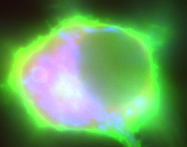

In [13]:
brightness(get_img(), 0.1)# 0-1
contrast(get_img(), 1) #0-Inf (1 is normal)
crop(get_img(), (500,500), row_pct = 0.9, col_pct = 0.9) #Don't use
crop_pad(get_img(), 500, padding_mode = 'zeros')
dihedral(get_img(), k=8) #There are 8
flip_lr(get_img())
jitter(get_img(), 0.5)  #Beyond 0.5 is too strong
pad(get_img(), padding = 20, mode = 'border')
magnitudes = torch.tensor(np.zeros(8))
magnitudes[0] = 1   #
perspective_warp(get_img(), magnitudes)
rotate(get_img(), 75)
#get_img().rgb_randomize(0, 0.2)  #Not implemented in my version
skew(get_img(), 0, 2)  #First number is direction, second is magnitude
get_img().tilt(0, 2)   #First number is direction, second is magnitude
get_img().zoom(1.2)


get_img().resize(1000).refresh()
get_img().squish(scale = 0.5) #
tfms = symmetric_warp(magnitude = (-0.1, -0.5))
get_img().apply_tfms(tfms, padding_mode = 'zeros')


get_img()

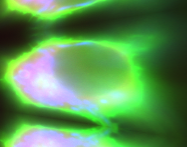

In [126]:
symmetric_warp(get_img(), magnitude = (-0.1, -0.5, -0, 0))

In [48]:
ax.axis['xzero'].set_label("x")

AttributeError: 'numpy.ndarray' object has no attribute 'axis'

(0.0, 1.0, 0.0, 1.0)

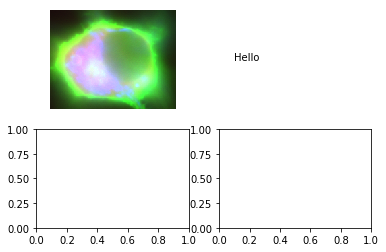

In [179]:
fig, axes = plt.subplots(2,2)
get_img().show(axes[0][0])
axes[0][0].xaxis.set_visible(False)
axes[0][1].text(0.1,0.5,'Hello')
axes[0][1].axis('off')

In [31]:
for transform in get_transforms()[0]:
    print (transform)

RandTransform(tfm=TfmCrop (crop_pad), kwargs={'row_pct': (0, 1), 'col_pct': (0, 1), 'padding_mode': 'reflection'}, p=1.0, resolved={}, do_run=True, is_random=True)
RandTransform(tfm=TfmPixel (flip_lr), kwargs={}, p=0.5, resolved={}, do_run=True, is_random=True)
RandTransform(tfm=TfmCoord (symmetric_warp), kwargs={'magnitude': (-0.2, 0.2)}, p=0.75, resolved={}, do_run=True, is_random=True)
RandTransform(tfm=TfmAffine (rotate), kwargs={'degrees': (-10.0, 10.0)}, p=0.75, resolved={}, do_run=True, is_random=True)
RandTransform(tfm=TfmAffine (zoom), kwargs={'scale': (1.0, 1.1), 'row_pct': (0, 1), 'col_pct': (0, 1)}, p=0.75, resolved={}, do_run=True, is_random=True)
RandTransform(tfm=TfmLighting (brightness), kwargs={'change': (0.4, 0.6)}, p=0.75, resolved={}, do_run=True, is_random=True)
RandTransform(tfm=TfmLighting (contrast), kwargs={'scale': (0.8, 1.25)}, p=0.75, resolved={}, do_run=True, is_random=True)


In [14]:
example_image_path = root_path/r'FullImage'/r'1_10_MMStack_Pos02.ome.tif'

def get_example_image():
    return open_image_2(example_image_path)


def plot_individual_transforms(tfms, **kwargs):
    title_font_size = 25
    rows = columns = np.ceil(np.sqrt(len(tfms[0]))).astype('uint8')
    fig, axes = plt.subplots(rows, columns, figsize = (40,40))
    num_transforms = len(tfms[0])

    for i,ax in enumerate(axes.flatten()):

        if i == 0:   #Plot original image
            ax.set_title('Original Image', fontsize = title_font_size)
            get_example_image().show(ax=ax)


        elif i < (len(tfms[0])+1):
            ax.set_title(str(tfms[0][i-1])[27:54], fontsize = title_font_size)
            get_example_image().apply_tfms(tfms[0][i-1]).show(ax=ax)

        else:
            ax.axis('off')
            
    return (fig)

            
#From the FastAI Docs
def plots_f(rows, cols, width, height, **kwargs):
    [get_example_image().apply_tfms(tfms[0], **kwargs).show(ax=ax) for i,ax in enumerate(plt.subplots(
        rows,cols,figsize=(width,height))[1].flatten())]

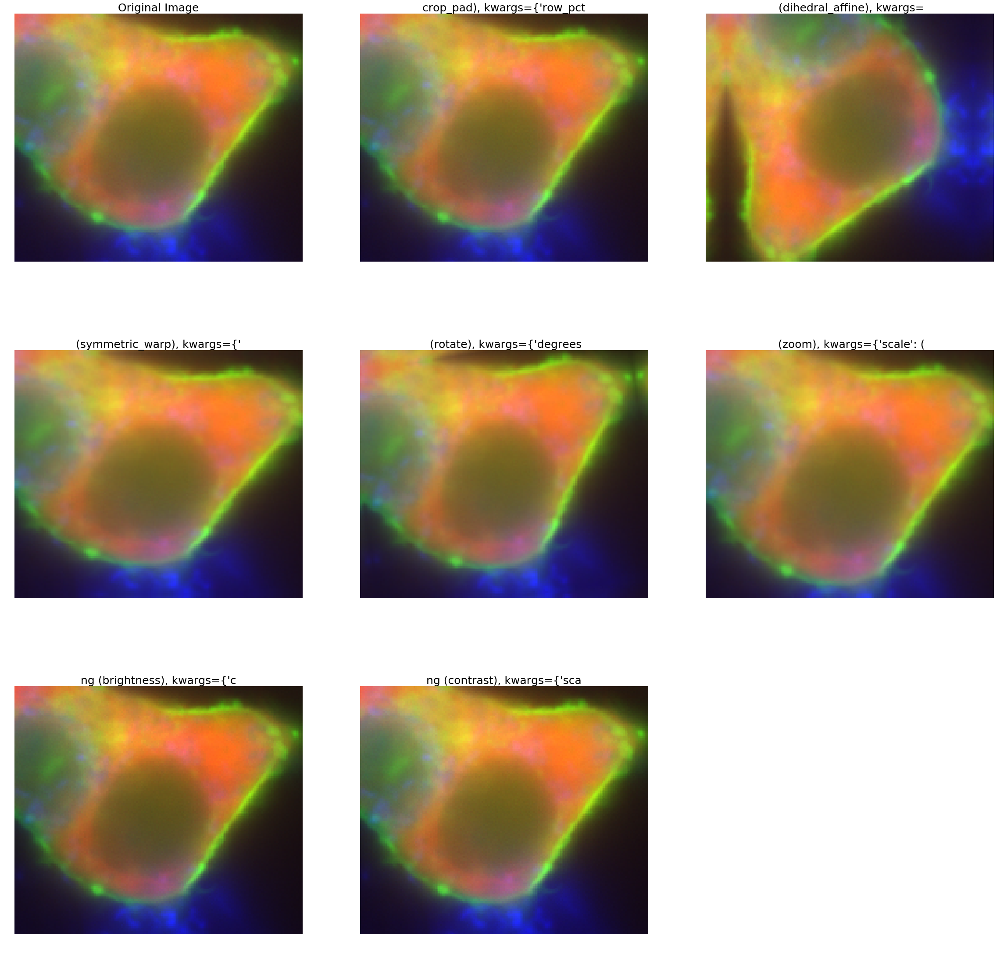

In [552]:
t1 = get_transforms(flip_vert=True)

fig = plot_individual_transforms(t1)
fig.savefig(root_path/'figure.eps', format = 'eps' )

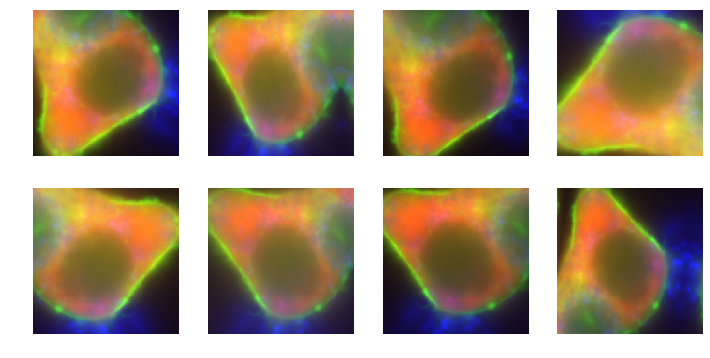

In [547]:
plots_f(2, 4, 12, 6, size=224)

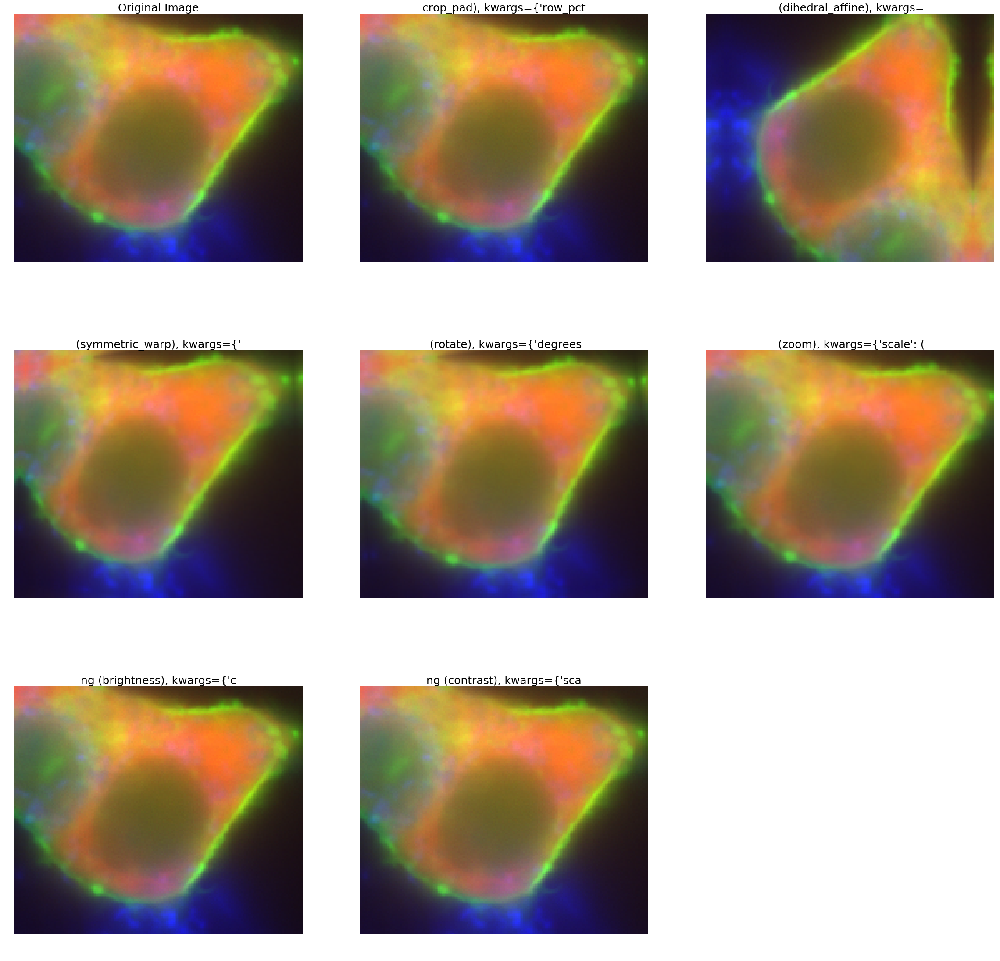

In [543]:


title_font_size = 25
rows = columns = np.ceil(np.sqrt(len(tfms[0]))).astype('uint8')
fig, axes = plt.subplots(rows, columns, figsize = (40,40))
num_transforms = len(tfms[0])

for i,ax in enumerate(axes.flatten()):
    
    if i == 0:   #Plot original image
        ax.set_title('Original Image', fontsize = title_font_size)
        get_example_image().show(ax=ax)
        
        
    elif i < (len(tfms[0])+1):
        ax.set_title(str(tfms[0][i-1])[27:54], fontsize = title_font_size)
        get_example_image().apply_tfms(tfms[0][i-1]).show(ax=ax)
    
    else:
        ax.axis('off')

In [493]:
ax.reshape(-1).shape

(25,)

<a id='model_tester'></a>
## Model Explorer (WIP - Not finished)

Note, this is still a work in progress.  The ultimate goal is to be able to explore the results of your training as well as to better understand how predictions work (for implementation in the analysis program)


There are two ways to predict an image once you have a trained learner: learn.predict() or learn.predict_batch() <br>

With the batch predict, your outputs will be in the form: 


- One batch will be in the form:
- one_batch[0] Contains all of the images   (Shape = [# images, 3, 200, 200]
- one_batch[1] Contains all of the masks
- one_batch[2] contains the probabilities

- The outputs will be in the form [image][mask]



For a single image, the outputs will be:
- dfsdf



In [7]:
"""
Fetch one batch from the dataloader and predict the outputs

"""
batch_size = learner.data.batch_size

one_batch = next(iter(learner.dl(ds_type = DatasetType.Valid)))

outputs = learner.pred_batch(batch = one_batch)



NameError: name 'learner' is not defined

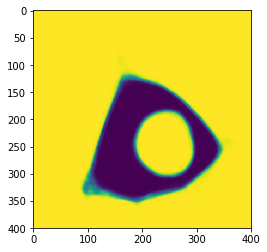

In [73]:
plt.imshow(outputs[2][0])

In [52]:
"""
Fetch one item from the dataset
"""

image, mask = learner.data.train_ds[0]

output = learner.predict(image)

In [55]:
len(output)

3

In [34]:
for i in range( len(outputs)):
    print (i, ": ", len(outputs[i]), type(outputs[i]), outputs[i].shape)


0 :  3 <class 'torch.Tensor'> torch.Size([3, 400, 400])
1 :  3 <class 'torch.Tensor'> torch.Size([3, 400, 400])
2 :  3 <class 'torch.Tensor'> torch.Size([3, 400, 400])
3 :  3 <class 'torch.Tensor'> torch.Size([3, 400, 400])


In [ ]:
#Show the results of a batch


def rearranged_image(img):
    rearranged_image = np.asarray(img)
    rearranged_image = np.moveaxis(rearranged_image, 0, -1)
    return (rearranged_image)



num_images = batch_size

fig, ax = plt.subplots(num_images,3, figsize = (20,20))

for i in range(num_images):
    ax[i][0].imshow(rearranged_image(one_batch[0][i,:,:,:]))
    ax[i][1].imshow(one_batch[1][i,0,:,:])
    ax[i][2].imshow(rearranged_image(outputs[i]))




In [9]:
#Show an entire batch...
rows = columns = np.sqrt(batch_size)


fig, axes = plt.subplots(rows,columns, figsize = (20,20))

axes_flat = axes.flatten()

for i in range(batch_size):
    axes_flat[i].imshow(outputs[1][i,0,:,:])
    

NameError: name 'batch_size' is not defined

In [291]:
img2 = open_image_2(example_image_path)
single_output = seg_learn.predict(img2)

## Test your imported models

In [49]:
size = 400
mito_model = load_learner(Path(r'models'), 'mito-learn.pkl')

In [50]:
filepath = Path(r"D:\[] ML Dataset\Datasets\2019-03-17 AD293 Dataset 24 Hours after Replating-Louise\Debug Outputs (Subcells)\2\0.ome.tif")

In [51]:
img = open_image_2(filepath)

Exception... (302, 422, 3)
Exception... (302, 422, 3)
Exception... (302, 422, 3)


990

In [52]:
CURRENT_CHANNELS = [0,1,2]
img = open_image_2(filepath)

Exception... (302, 422, 3)
Exception... (302, 422, 3)
Exception... (302, 422, 3)


In [53]:
img.shape

torch.Size([3, 302, 422])

In [54]:
o1, o2, o3 = mito_model.predict(img)

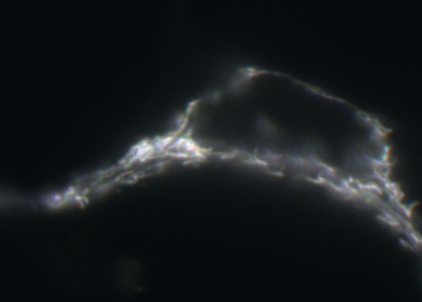

In [55]:
img

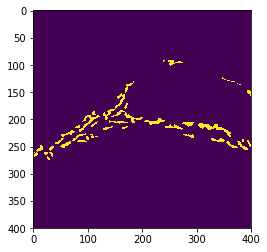

In [56]:
plt.imshow(np.asarray(o2).squeeze())

In [90]:
img2 = imageio.imread(str(filepath))

In [91]:
image_array = np.asarray(img2)

In [92]:
image_array.shape

(302, 422, 3)

In [67]:
#img_array = open_image_array(np.moveaxis(img2, -1, 0))
img_array = open_image_array(img2)
img_array.shape

torch.Size([302, 422, 3])

In [68]:
CURRENT_CHANNELS = [9,12,15]  

In [112]:
from skimage.measure import block_reduce

sz = 400
network = mito_model
data = image_array

h, w, c = data.shape
print(data.shape)
scale_factor = 1 + max(h//sz, w//sz)   
print ("Scale Factor is:", scale_factor, h//sz, w//sz)

if scale_factor > 1:
    padded_array = np.zeros((h+h%scale_factor,
                             w+w%scale_factor,
                             3))
    padded_array[:h,:w,:] = data
    data = block_reduce(padded_array, (scale_factor, scale_factor, 1), func = np.mean)


data = np.moveaxis(data, -1, 0)     #New shape is (3, sz, sz)

new_c, new_h, new_w = data.shape

print (f"Before the input array, shape is {data.shape}")


input_array = np.zeros((3,sz,sz))
input_array[:, :new_h, :new_w] = data.copy()

print ("In the input array", input_array.shape)




input_array =  open_image_array(input_array)
print ("After Open Image", input_array.shape)
(o1, o2, o3) = network.predict(input_array)

prediction = np.asarray(o2.squeeze())

if prediction.ndim == 2: prediction = np.expand_dims(prediction, 0)


print (f"The shape of the prediction is {prediction.shape}")


if scale_factor > 1:
    prediction = np.kron(prediction, np.ones((1, scale_factor, scale_factor)))

print("Right before segmentation the results are:", prediction.shape)
final_segmentation = prediction[0, :h, :w]>0

print ("The shape of the final segmentation is", final_segmentation.shape)
print ("The maximum value of the prediction is", np.amax(prediction))
print ("The mean value is: ", np.mean(prediction))


(302, 422, 3)
Scale Factor is: 2 0 1
Before the input array, shape is (3, 151, 211)
In the input array (3, 400, 400)
After Open Image torch.Size([3, 400, 400])
The shape of the prediction is (1, 400, 400)
Right before segmentation the results are: (1, 800, 800)
The shape of the final segmentation is (302, 422)
The maximum value of the prediction is 1.0
The mean value is:  0.0060625


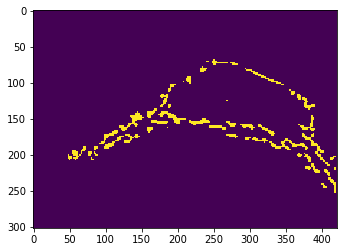

In [113]:
plt.imshow(final_segmentation)

In [114]:
final_segmentation.shape

(302, 422)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


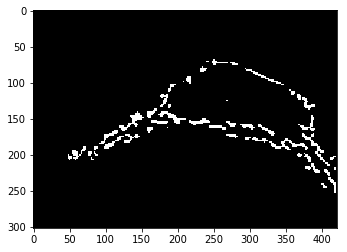

In [115]:
plt.imshow(np.multiply(image_array, np.expand_dims(final_segmentation, 2)))

In [134]:
mito_model.predict(open_image_array(np.zeros(1,1)))

TypeError: data type not understood

In [151]:


test = open_image_array(np.ones((3,11,11)))

In [152]:
o1, o2, o3 = mito_model.predict(test)

In [153]:
o2.shape[2]

400

## Building it from Scratch

In [30]:
CURRENT_CHANNELS = [0,3,6]   

#seg_path = Path(r"")

tfms = get_transforms(flip_vert = True)
size = 200

seg_data = (SegMultiImageList
          .from_folder(seg_path)
          .split_by_rand_pct()
          .label_from_func(get_y_func, classes = codes)
          .transform(tfms, size = size, tfm_y = True)
          .databunch(num_workers = 0, bs = 8))


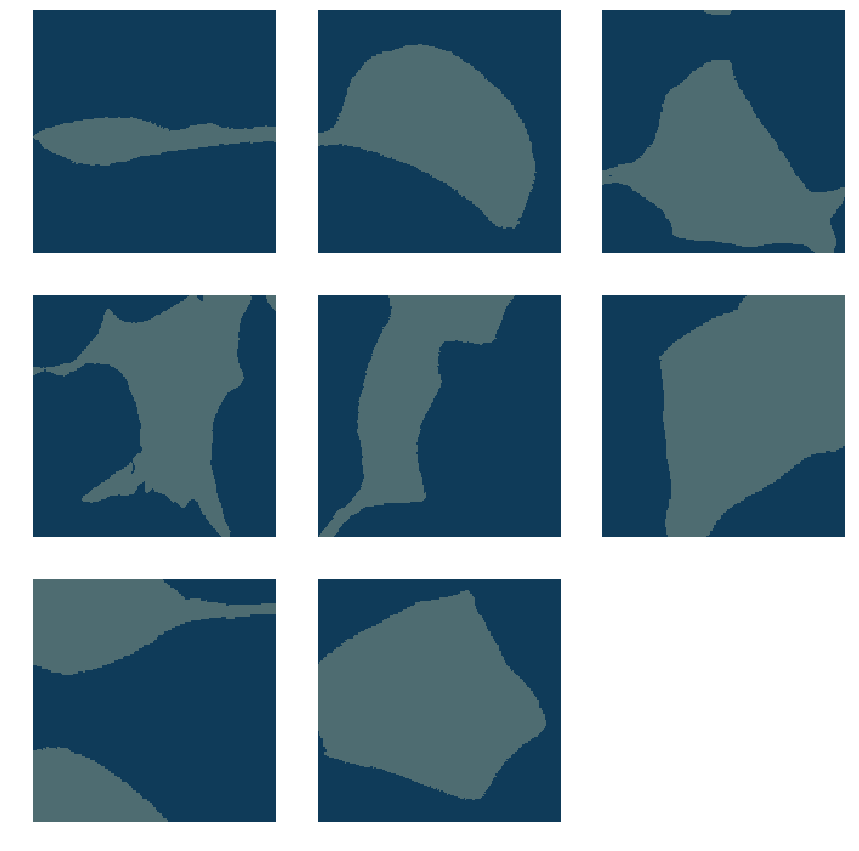

In [31]:
seg_data.show_batch(4)

In [22]:
seg_learn = unet_learner(seg_data, models.resnet34, metrics = [acc_segmentation])

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


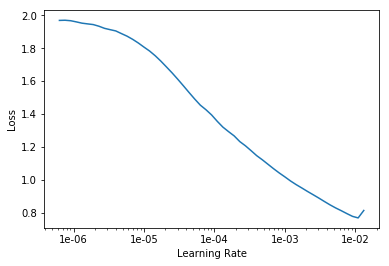

In [23]:
lr_find(seg_learn)
seg_learn.recorder.plot()

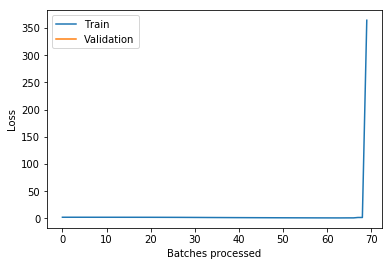

In [25]:
lr = 1e-4

In [26]:
seg_learn.fit_one_cycle(5)

epoch,train_loss,valid_loss,acc_segmentation,time
0,2.773584,0.694603,0.719702,00:03
1,1.793469,0.508825,0.856702,00:01
2,1.261183,0.405423,0.852607,00:01
3,0.971995,0.385844,0.928161,00:01
4,0.799737,0.300803,0.935277,00:01


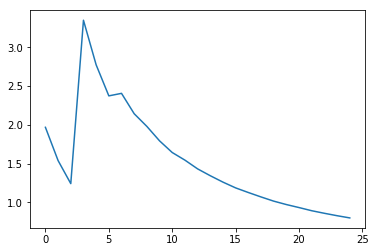

epoch,train_loss,valid_loss,acc_segmentation,time
0,0.375872,0.379335,0.820270,00:02
1,0.411993,0.375108,0.834520,00:02
2,0.547698,0.530068,0.672375,00:02
3,0.545161,0.423117,0.790050,00:02
4,0.528920,0.435663,0.774743,00:02
5,0.518063,0.396778,0.814414,00:02
6,0.494173,0.408725,0.809766,00:02
7,0.466907,0.363054,0.837561,00:02
8,0.452890,0.343096,0.844868,00:02
9,0.437871,0.356431,0.840643,00:02


epoch,train_loss,valid_loss,acc_segmentation,time
0,0.322792,0.360888,0.839670,00:02
1,0.336214,0.355450,0.840866,00:02
2,0.351537,0.350745,0.842777,00:02
3,0.348882,0.349455,0.841559,00:02
4,0.345865,0.342587,0.844086,00:02
5,0.349387,0.339805,0.844727,00:02
6,0.348608,0.338564,0.844734,00:02
7,0.345406,0.338787,0.844941,00:02
8,0.346490,0.341917,0.843857,00:02
9,0.346011,0.341589,0.843566,00:02


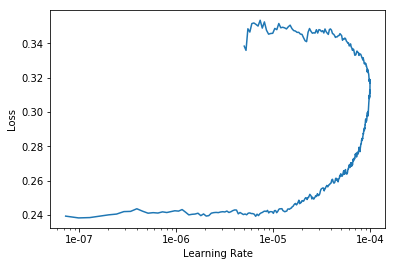

In [128]:
seg_learn.fit_one_cycle(10)

seg_learn.unfreeze()

seg_learn.fit_one_cycle(100, slice(lr))
seg_learn.recorder.plot()

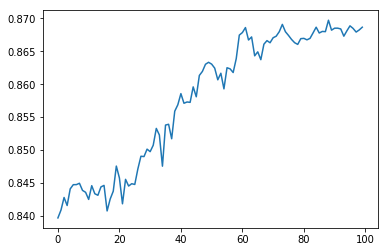

In [129]:
plt.plot(np.asarray(seg_learn.recorder.metrics))

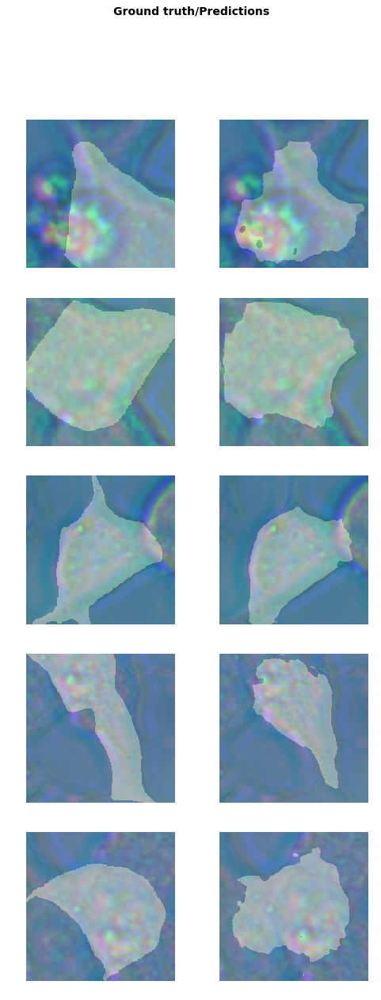

In [130]:
seg_learn.show_results(3)

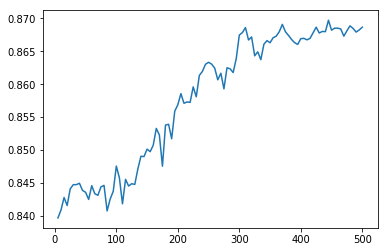

In [131]:
np.asarray(seg_learn.recorder.metrics)
seg_learn.recorder.plot_metrics()

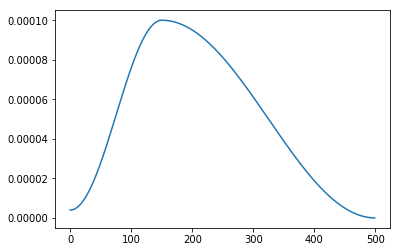

In [132]:
plt.plot(np.asarray(seg_learn.recorder.lrs))

In [133]:
seg_learn.save(model_path/'seg_test')

In [134]:
seg_learn.export(model_path/'seg_exp.pkl')

## Helper Functions

<a id = 'mask_normalization'></a>
### Mask Normalization

In [12]:
# Normalize the masks...

mask_path = Path(r"C:\Users\William\.fastai\data\Organelle Trainers\Whole Cell Trainer\Mask\20190412INS1EMonChannel0")

parent_path = mask_path.parent

save_path = parent_path/'Mask_Norm'

save_path.mkdir(exist_ok = True)

for files in mask_path.iterdir():
    #print (files.name)
    reader = imageio.get_reader(str(files))
    img = reader.get_data(0)
    img = np.divide (img, 255).astype('uint8')
    
    imageio.imwrite(str(save_path/files.name), img)
    #print(np.amax(img))
    


## Filter Unlabelled

Be careful because this can delete files!!!

In [28]:
root_path = Path(r"C:\Users\William\.fastai\data\Organelle Trainers\Whole Cell Trainer")
image_path = Path(r"C:\Users\William\.fastai\data\Organelle Trainers\Whole Cell Trainer\FullImage\20190412INS1EMonChannel0")


root_image_path = root_path/'FullImage'
root_mask_path = root_path/'Mask_Norm'

for files in image_path.iterdir():
    sub_path = files.relative_to(root_image_path)
    sub_path = sub_path.parent/sub_path.name.replace('.ome.tif', '.png')
    mask_path = root_mask_path/sub_path
    if not mask_path.exists():
            files.unlink()
    
    

WindowsPath('20190412INS1EMonChannel0')

In [37]:
path = Path(r"D:\[] ML Dataset\Segmentation Training\Mitochondria\2019-01-28 Mitotracker\Segmented_Ground_Truth\20190128Mitotracker100nM\Baseline_1_MMStack_Pos00.png")

In [45]:
read = imageio.get_reader(str(path))
img = read.get_data(0)[:,:,0]

In [57]:
# Normalize the masks...
seg_path = Path(r"D:\[] ML Dataset\Segmentation Training\Mitochondria\2019-01-28 Mitotracker\Segmented_Ground_Truth\20190128Mitotracker100nM2")


parent_path = seg_path.parent

save_path = parent_path/'2'

save_path.mkdir(exist_ok = True)

for files in seg_path.iterdir():
    #print (files)
    reader = imageio.get_reader(str(files))
    img = reader.get_data(0)[:,:,0]
    img = np.divide (img, 255).astype('uint8')
    
    imageio.imwrite(str(save_path/files.name), img)
    #print(np.amax(img))
    

In [ ]:
fig, ax = plt.subplots(1,1, figsize = (10, 5))
ax.bar(range(8), final_acc)
ax.set_xticklabels(training_labels[0:3], fontsize = 5)
ax.set_title("Final Training Accuracies", fontsize = 15)
fig.savefig(figures_path/'accuracy.eps', format = 'eps' )
fig.savefig(figures_path/'accuracy.png', format = 'png' )

In [ ]:
    
im3r = imageio.get_reader(str(example_image_path))


img5 = im3r.get_data(11)/3 + im3r.get_data(3)/3 + im3r.get_data(6)/3

plt.imshow(img5)

# Old Functions

## Things I was playing around with before...

In [14]:
#Should add some custom parameters (ex. model, bs, etc.) that all have defaults
def training_cycle():

    
    tfms = get_transforms(flip_vert = True)
    get_mask_func = get_y_lambda_function(root_path)
    
    seg_data = (SegMultiImageList
              .from_folder(seg_path)
              .split_by_rand_pct()
              .label_from_func(get_y_func, classes = codes)
              .transform(tfms, size = size, tfm_y = True)
              .databunch(num_workers = 0, bs = 4))

    seg_data.show_batch(2)

    

    
    

    #Should play around with the architecture
    seg_learn = unet_learner(seg_data, models.resnet34, metrics = [acc_segmentation])

    seg_learn.fit_one_cycle(10)
    
    seg_learn.unfreeze()
    
    seg_learn.fit_one_cycle(100, slice(lr))



    loss_results = np.asarray(seg_learn.recorder.losses)
    acc_metric_results = np.asarray(seg_learn.recorder.metrics)
    final_acc = acc_metric_results[-5:].mean()
    

    

    return (seg_learn, loss_results, acc_metric_results, final_acc)


In [266]:
def save_image(filepath, output_path):
    
    image_open = np.asarray(bioformats.load_image(filepath, c = 0, z=0, t=3, rescale=False))
    image_para = np.asarray(bioformats.load_image(filepath, c = 0, z=0, t=4, rescale=False))
    image_perp = np.asarray(bioformats.load_image(filepath, c = 0, z=0, t=5, rescale=False))
    
    image2 = np.dstack([image_open, image_para, image_perp])
    image2 = image2/np.amax(image2)
        
    img = image2*255
    img = img.astype('uint8')
    print (np.amax(img))
    #img = Image.fromarray(image2, 'RGB')
    print (type (img))
    plt.imshow(img)
    outpath = "D:/Documents/Documents/0000 New Scope/Box Testing Baseline/Baseline_1/Baseline_1_MMStack_1-Pos_000_000BBB.ome.jpg"
    
    
    imageio.imwrite(outpath, img)
    #cv2.imwrite(outpath, img)
    #img.save(outpath, 'JPEG')
    
    
    
    return (None)

In [17]:
def segment_image(Parameters, ROIs, root_dir, sub_dir, filename):
    
    """
    Use this to create the files used to train the YOLO Component of the dataframe
    
    
    
    
    
    """
    
    
    
    
    
    
    print (root_dir, sub_dir, filename)
    print("Segmenting image.... :)")
    
    #Parameters
    #subimage_height = 370 
    #subimage_width = 632 #or 316
    
    #subimage_height = 740
    #subimage_width = 1264
    
    subimage_height = 986
    subimage_width = 1685

    
    
    filepath = f'{root_dir}{sub_dir}{os.sep}{filename}'
    annotations_dir = f'{root_dir}{os.sep}Annotations{sub_dir}'
    image_dir = f'{root_dir}{os.sep}JPEGImages{sub_dir}'
    
    
    for dirs in [annotations_dir, image_dir]:
        if (not os.path.isdir(dirs)):
            os.makedirs(dirs)
    
    
    #Preprocess the image
    image_open = np.asarray(bioformats.load_image(filepath, c = 0, z=0, t=3, rescale=False))
    image_para = np.asarray(bioformats.load_image(filepath, c = 0, z=0, t=4, rescale=False))
    image_perp = np.asarray(bioformats.load_image(filepath, c = 0, z=0, t=5, rescale=False))
    
    img = np.dstack([image_open, image_para, image_perp])
    img = img/np.amax(img)
        
    img = img*255
    img = img.astype('uint8')
    plt.imshow(img)
    
    
    
                
    
    
    
    
    print ("Shape", img.shape)
    
    height, width, depth = img.shape
    print (ROIs)
    
    
    
    #make the subimages - images should be within 
    for i in range (height//subimage_height):
        for j in range (width//subimage_width):
            xmin = j*subimage_width
            xmax = (j+1)*subimage_width
            ymin = i*subimage_width
            ymax = (i+1)*subimage_width
            
            
            
            subimage = img[ ymin:ymax, xmin:xmax, :]
            
            
            subROIs = ROIs[(ROIs['X']>xmin) & 
                           (ROIs['X']<xmax) & 
                           (ROIs['Y']>ymin) & 
                           (ROIs['Y']<ymax)].copy()
            
            
            
            
            #If ROI list is not empty           
            if len(subROIs)>0:
                
                #mod ROIs to fit the new size
                subROIs['xmin'] = subROIs['xmin'] - xmin
                subROIs['xmax'] = subROIs['xmax'] - xmin
                subROIs['ymin'] = subROIs['ymin'] - ymin
                subROIs['ymax'] = subROIs['ymax'] - ymin
                
                #Check for any truncations
                subROIs['Truncated'] = ((subROIs['xmin']<0) | (subROIs['xmax']>xmax) | 
                                        (subROIs['ymin']<0) | (subROIs['ymax']>ymax))
                
                
                
                
                #print (i, j, xmin, xmax, ymin, ymax, len(subROIs))
                print (subROIs)
                #Save the jpeg files
                imageio.imwrite(f'{image_dir}{os.sep}{filename}'.replace('.ome.tif', f'{i}{j}.jpg' ), subimage) #may need to set to .ome.tif
                #Output the labels
                
               
                
                #may need to set to .ome.tif
                output_filename = f'{root_dir}{os.sep}Annotations{sub_dir}{os.sep}{filename}'.replace(".ome.tif", f"{i}{j}--labels.xml")
                
                labels = {'Height': subimage.shape[0], 
                          'Width': subimage.shape[1], 
                          'Filename' : (f'{filename}'.replace('.ome.tif', f'{i}{j}.jpg')) , 'Folder': f'{sub_dir}'[1:]}  
                #may need to set to .ome.tif
                
                output_labels (labels, subROIs, output_filename)
                
                
                
                
                
                

        
        

            
    

    
    
    
    
    
    

    #Save the jpeg files
    #imageio.imwrite(f'{image_dir}{os.sep}{filename}'.replace('.ome.tif', '.jpg' ), img)
    
    
    
    #Output the labels
    #output_filename = f'{root_dir}{os.sep}Annotations{sub_dir}{os.sep}{filename}'.replace(".ome.tif", "--labels.xml")
    #print (output_filename)
    #output_labels (Parameters, ROIs, output_filename)
    
    
    return(None)

In [ ]:
class ImageParams():
    def __init__(self, directory, filename, channel_array, image_type_array, channel_thresholds):
        self.directory = directory 
        self.filename = filename
        self.file_path = (f'{directory}{os.sep}{filename}')

        
        
        self.dir_name = directory.replace(os.path.dirname(directory), "")
        self.upper_dir_name = os.path.dirname(directory).replace (os.path.dirname(os.path.dirname(directory)), "")[1:]
        
        self.ROI_list = []
        
        
        image = Image.open(self.file_path)
        self.total_frames = image.n_frames
        self.width = image.width
        self.length = image.height
        
        self.channel_array = channel_array
        self.image_type_array = image_type_array
        
        self.channel_thresholds = channel_thresholds
        
        assert (len(channel_array) == len(image_type_array)), "Anisotropy and Channel arrays are not of equal length"
              
        self.channel_offset = np.zeros(len(channel_array))
        
        images_per_timepoint = 0
        for index, items in enumerate(channel_array):
            #print (index, items, images_per_timepoint)
            self.channel_offset[index] = images_per_timepoint
            images_per_timepoint += items
        
        self.images_per_timepoint = images_per_timepoint
        self.timepoints = self.total_frames // images_per_timepoint

In [ ]:
#Create the pickle file...



DEBUG = True        # Enable some debug prints with extra information
#ROOT = '../data'    # Root folder where the VOCdevkit is located

#ROOT = f'C:{os.sep}Users{os.sep}William{os.sep}Desktop{os.sep}Box Testing Baseline'
#ROOT = r"D:\AAA\2018-09-16 YOLO Training Set 2\More Confluent"
ROOT = r"D:\[] ML Dataset\OneDrive_1_1-22-2019\More Confluent"

ROOT = r"D:\AAA\2018-09-16 YOLO Training Set 2\Less Confluent"
#anno_directory = r"D:\AAA\2018-09-16 YOLO Training Set 2\More Confluent\Annotations\Baseline_1"
anno_directory = r"D:\[] ML Dataset\OneDrive_1_1-22-2019\More Confluent\Annotations\Baseline_1"


TRAINSET = [
    ('2012', 'train'),
    ('2012', 'val'),
    ('2007', 'train'),
    ('2007', 'val'),
    ]
TESTSET = [
    ('2007', 'test'),
    ]


def identify(xml_file):
    root = ET.parse(xml_file).getroot()
    folder = root.find('folder').text
    filename = os.path.splitext(root.find('filename').text)[0]
    #return f'{folder}/JPEGImages/{filename}'
    return f'{folder}{os.sep}{filename}'


if __name__ == '__main__':
    
    #find all files for the training set...
    print('Getting training annotation filenames')
    train = []
    
    """for (year, img_set) in TRAINSET:
        with open(f'{ROOT}/VOCdevkit/VOC{year}/ImageSets/Main/{img_set}.txt', 'r') as f:
            ids = f.read().strip().split()
        train += [f'{ROOT}/VOCdevkit/VOC{year}/Annotations/{xml_id}.xml' for xml_id in ids]
    """
    

    
    anno_list = os.listdir(anno_directory)
    anno_list = [x for x in anno_list if x.endswith('.xml')]
    train = [f'{anno_directory}{os.sep}{x}' for x in anno_list]
    
        
    
        
    if DEBUG:
        print(f'\t{len(train)} xml files')

    print('Parsing training annotation files')
    #train_annos = bbb.parse('anno_pascalvoc', train, identify)
    train_annos = bbb.parse('anno_pascalvoc', train, identify)
    
    
    # Remove difficult for training
    for k,annos in train_annos.items():
        for i in range(len(annos)-1, -1, -1):
            if annos[i].difficult:
                del annos[i]

    print('Generating training annotation file')
    bbb.generate('anno_pickle', train_annos, f'{ROOT}/train.pkl')

    print("Done!!")
    
    
    

    """
    print('Getting testing annotation filenames')
    test = []
    for (year, img_set) in TESTSET:
        with open(f'{ROOT}/VOCdevkit/VOC{year}/ImageSets/Main/{img_set}.txt', 'r') as f:
            ids = f.read().strip().split()
        test += [f'{ROOT}/VOCdevkit/VOC{year}/Annotations/{xml_id}.xml' for xml_id in ids]

    if DEBUG:
        print(f'\t{len(test)} xml files')

    print('Parsing testing annotation files')
    test_annos = bbb.parse('anno_pascalvoc', test, identify)

    print('Generating testing annotation file')
    bbb.generate('anno_pickle', test_annos, f'{ROOT}/test.pkl')
"""

In [ ]:
def find_files_old(path, directory_list = {}):
    all_files = os.listdir(path)
    #print (all_files)
    for files in all_files:
        #print (path, os.path.dirname(path))
        
        #When you find the appropriate file, add the directory to the dictionary for processing
        if os.path.isfile(f'{path}{os.sep}{files}'):
            #print ("Found a file")
            if files.endswith("ome.tif"):
                #print (f"Ends with ome.tif ({files})")
                prev_directory = os.path.dirname(path)
                current_directory = path.replace(prev_directory, "")
                if prev_directory in directory_list:
                    directory_list[prev_directory][current_directory] = None
                                    
                else:
                    directory_list[prev_directory] = {current_directory : None}
                
                
                
        elif os.path.isdir(f'{path}{os.sep}{files}'):
            directory_list = find_files(f'{path}{os.sep}{files}', directory_list)
            #print ("Found a directory")
    
    
    return (directory_list)

# Main Functions (Now in the trainer_functions.py file)
Helper functions for the other sections below

In [7]:
def find_files(path, directory_list = {}, double_subpath = True):

    
    
    for subpath in path.iterdir():
        if subpath.is_file() and subpath.suffixes == ['.ome', '.tif']: #['.ome', '.tif']:
            
            if double_subpath == True:
                file_path = Path(subpath.parent.name)/subpath.name
                root_path = subpath.parent.parent
            else:
                file_path = subpath.name
                root_path = subpath.parent
                
                
            
            if root_path in directory_list:
                directory_list[root_path][file_path] = None

            else:
                directory_list[root_path] = {file_path : None}
                
        elif subpath.is_dir():
            directory_list = find_files(subpath, directory_list, double_subpath)
      
    return (directory_list)

In [8]:
def iterate_through_files(directory_list, Parameters, dataframes = []):
    """
    The purpose of this function is to iterate through all of the files in the directory list and analyze
        the relevant files.
        
        
    Input:
    directory_list is a dictionary of root directories containing dictionaries of subdirectories
        In most cases, there will be one subdirectory per root_directory, however this may not
        always be the case
    
    
    Parameters - the overall imaging parameters passed through to the analysis
        .suffix - the suffix used to identify images of interest
    
    
    dataframes - the list of dataframes. In most cases, you will be creating a new one
    
    
    """ 

    subsegmentation = Parameters["subsegmentation"]
  
    
    for root_dir in directory_list:
        #note: there will usually only be one subdirectory per root_dir
        annotation_dir = root_dir/'Annotations'
        image_dir = root_dir/'JPEGImages'
        
        print (annotation_dir)
        print (root_dir)
        
        for files in directory_list[root_dir]:

            #if files.suffix == (".tif"):  #This is unneccessary since we already did the check before...

            ROIs = read_ROI_File(root_dir/files)
            #Process the image if there is an associated ROI file
            #print (ROIs)
            if (not ROIs.empty):
                ROIs = process_ROI_dataframe(ROIs)
                segment_ROI_image(Parameters, ROIs, root_dir, files)

                if subsegmentation == True:
                    subsegment_image(Parameters, ROIs, root_dir, files)

    
    return (dataframes)
            

In [9]:
def segment_ROI_image(Parameters, ROIs, root_dir, sub_path):
    
    """
    Use this to create the segmentations around each ROI (more intact cells) used to train the YOLO Component of the dataframe
    

    
    """
    ch = Parameters["channels"]
    subimage_height = Parameters["subimage_height"] 
    subimage_width = Parameters["subimage_width"]


    print (root_dir, sub_path)
    print("Segmenting around the ROIs image.... :)")    

    
   
    
    filepath = root_dir/sub_path
    annotations_dir = root_dir/'Annotations'/sub_path.parent
    image_dir = root_dir/'JPEGImages'/sub_path.parent
    
    print ("IM", image_dir)
    
    
    for dirs in [annotations_dir, image_dir]:
        if (not os.path.isdir(dirs)):
            os.makedirs(dirs)
    
    
    #Preprocess the image
    
    reader = imageio.get_reader(str(filepath))
    image_open = np.asarray(reader.get_data(ch[0]))
    image_para = np.asarray(reader.get_data(ch[1]))
    image_perp = np.asarray(reader.get_data(ch[2]))
    
    
    img = np.dstack([image_open, image_para, image_perp])
    img = img/np.amax(img)        
    img = img*255
    img = img.astype('uint8')
    plt.imshow(img)
    
    height, width, depth = img.shape
    print ("Shape", img.shape)
    print (ROIs)
    
    
    for i in range(len(ROIs)):
        x_min = int(ROIs.loc[i, 'xmin'])
        x_max = int(ROIs.loc[i, 'xmax'])
        y_min = int(ROIs.loc[i, 'ymin'])
        y_max = int(ROIs.loc[i, 'ymax'])
        
        
        
        
        #x_length = x_max - x_min
        #y_length = y_max - y_min
        
        
        #Padding can be negative!
        #x_pad = (subimage_width - x_length)//2
        #y_pad = (subimage_height - y_length)//2
        
        x_centroid = (x_max + x_min)//2
        y_centroid = (y_max + y_min)//2
        
        print (f"Stats: X:{x_min}, {x_max}, {x_centroid} Y:{y_min}, {y_max}, {y_centroid}")

        xmin = max(0, (x_centroid - subimage_width//2))
        xmax = min(width, (x_centroid + subimage_width//2))
        ymin = max(0, (y_centroid - subimage_height//2))
        ymax = min(height, (y_centroid + subimage_height//2))
        
        subimage = img[ymin:ymax, xmin:xmax, :]

        subROIs = ROIs[(ROIs['X']>xmin) & 
                       (ROIs['X']<xmax) & 
                       (ROIs['Y']>ymin) & 
                       (ROIs['Y']<ymax)].copy()


        print ("Stats:", "X", xmin, xmax, "Y", ymin, ymax, subimage.shape, len(subROIs))

        #If ROI list is not empty           
        if len(subROIs)>0:

            #mod ROIs to fit the new size
            subROIs['xmin'] = subROIs['xmin'] - xmin
            subROIs['xmax'] = subROIs['xmax'] - xmin
            subROIs['ymin'] = subROIs['ymin'] - ymin
            subROIs['ymax'] = subROIs['ymax'] - ymin

            #Check for any truncations
            subROIs['Truncated'] = ((subROIs['xmin']<0) | (subROIs['xmax']>xmax) | 
                                    (subROIs['ymin']<0) | (subROIs['ymax']>ymax))


            #print (i, j, xmin, xmax, ymin, ymax, len(subROIs))
            print (subROIs)

            #Save the jpeg files
            JPEG_filename = image_dir/sub_path.name.replace('.ome.tif', f'{i}.jpg') #may need to set to .ome.tif
            imageio.imwrite(str(JPEG_filename), subimage)
            

            #Output the labels
            labels_filename = annotations_dir/sub_path.name.replace('.ome.tif', f'{i}--labels.xml') #may need to set to .ome.tif
            labels = {'Height': subimage.shape[0], 
                      'Width': subimage.shape[1], 
                      'Filename' : (sub_path.name.replace('.ome.tif', f'{i}.jpg')) , 'Folder': str(sub_path.parent)} #may need to set to .ome.tif         
            output_labels (labels, subROIs, labels_filename)
                
    
    return(None)

In [10]:
def subsegment_image(Parameters, ROIs, root_dir, sub_path):
    
    
    """
    Use this module to prepare the images to help create ground truths of the cells
    
    
    
    
    """
    
    channels = Parameters["subChannels"]
    suffix = Parameters["suffix"]
    
    print (root_dir, sub_path)
    print("subSegmenting image.... :)")
    
    ground_truths = Parameters["ground_truths"]
    ground_truth_suffix = Parameters["ground_truth_suffix"]
    
    
   
    
    filepath = root_dir/sub_path
    sub_JPEG_dir = root_dir/'Segmented_JPEGs'/sub_path.parent
    sub_cell_dir = root_dir/'Segmented_Image'/sub_path.parent
    sub_gt_dir = root_dir/'Segmented_Ground_Truth'/sub_path.parent

    
    
    for dirs in [sub_JPEG_dir, sub_gt_dir, sub_cell_dir]:
        if (not os.path.isdir(dirs)):
            os.makedirs(dirs)
    
    
    
    #Import the image for the JPEG
    
    reader = imageio.get_reader(str(filepath))
    images = []
    #Preprocess the image
    for channel in channels:
        img = np.asarray(reader.get_data(channel))

        #Should normalization happen after subsegmentation????
        img = img/np.amax(img)
        img = img*255
        img = img.astype('uint8')
        images.append(img)
        

    merged_img = np.dstack([images[0], images[1], images[2]])

    height, width, depth = merged_img.shape
    
    #Import the image for the real output
    full_image = imageio.volread(str(filepath))
    
    
    
    if ground_truths == True:
        gt_filepath = filepath.replace(suffix, ground_truth_suffix)
        print ("GT", gt_filepath)
        gt_img = np.asarray(bioformats.load_image(gt_filepath, c = 0, z=0, t=0, rescale=False))
        gt_img *= 255
        gt_img = np.dstack([gt_img, gt_img, gt_img])
    

    print (ROIs)
    
    
    for i in range(len(ROIs)):
        x_min = max(0, int(ROIs.loc[i, 'xmin']))
        x_max = min(width, int(ROIs.loc[i, 'xmax']))
        y_min = max (0, int(ROIs.loc[i, 'ymin']))
        y_max = min(height, int(ROIs.loc[i, 'ymax']))
        

        
        subJPEGimage = merged_img[y_min:y_max, x_min: x_max, :]
        imageio.imwrite(str(sub_JPEG_dir/sub_path.name.replace(suffix, f'{i}.jpg' )), subJPEGimage)
        
        
        subimage = full_image[:, y_min:y_max, x_min: x_max]
        imageio.volwrite(str(sub_cell_dir/sub_path.name.replace(suffix, f'{i}{suffix}' )), subimage)     
        
        
        
        
        print (merged_img.shape, x_min, x_max, y_min, y_max, subJPEGimage.shape, subimage.shape,) 
        
        
        
        
        if ground_truths == True:
             

            gt_subimage = gt_img[y_min:y_max, x_min: x_max, :].copy()
            print (gt_img.shape, x_min, x_max, y_min, y_max, gt_subimage.shape,) 
            imageio.volwrite(f'{sub_gt_dir}{os.sep}{filename}'.replace(suffix, f'{i}.png'), gt_subimage)
                
               
   
    
    return(None)

In [11]:
def read_ROI_File(filepath):
    
    text_path = str(filepath).replace(".ome.tif", "--labels.txt") #may need to set to .omo.tif
    print (text_path)
    
    if os.path.isfile(text_path):
        print ("Exists")
        ROI_List = pd.read_csv(text_path, index_col = False)
        #print (ROI_List)
        
        
    else:
        print ("No ROI File")
        ROI_List = pd.DataFrame()
    
    print (filepath)


    
    
    
    
    #except:
    #    ROI_List = None
    
    
    return (ROI_List)

In [12]:
def process_ROI_dataframe(ROIs):    
    
    
    #Switch X and Y for python standards
    
    ROIs['xmin'] = ROIs['X'] - ROIs['W']/2
    ROIs['xmax'] = ROIs['X'] + ROIs['W']/2
    ROIs['ymin'] = ROIs['Y'] - ROIs['H']/2
    ROIs['ymax'] = ROIs['Y'] + ROIs['H']/2
    
    
    
    
    #print (ROIs)
    
    return (ROIs)

In [13]:
def output_labels(Labels, subROIs, filepath):
    
    
    """
    Outputs the text labels into the VOC Pascal format for Lightnet to use
    
    Inputs:
    Filename
    subROIs - List of ROIs used to 
       
    
    
    
    """
    
    ROIs = subROIs.copy()
    #ROIs = ROIs.rename(columns={'xmin':'ymin', 'ymin':'xmin', 'xmax':'ymax', 'ymax':'xmax'})
    
    output_path = filepath

    objects = ['aeroplace', 'cat', 'sheep']
    
    
    annotation = ET.Element('annotation')
    tree = ET.ElementTree(annotation)


    folder = ET.SubElement(annotation, 'folder')
    folder.text = Labels['Folder']
    
    filename = ET.SubElement(annotation, 'filename')
    filename.text = Labels['Filename']

    source = ET.SubElement(annotation, 'source')
    source_database = ET.SubElement(source, 'database')
    source_annotation = ET.SubElement(source, 'annotation')
    source_image = ET.SubElement(source, 'image')
    source_flickrid = ET.SubElement(source, 'flickrid')

    owner = ET.SubElement(annotation, 'owner')
    owner_flickrid = ET.SubElement(owner, 'flickrid')

    
    
    object_subelements = ['name', 'pose', 'truncated', 'difficult', 'bndbox']
    bndbox_subelements = ['xmin', 'ymin', 'xmax', 'ymax']
    
    
    
    
    

    object_count = len(ROIs)
    print ("Object count is", object_count)
    Objects = []


    for i in ROIs.index:
        dictionary = {}

        dictionary['object'] = ET.SubElement(annotation, 'object')


        dictionary['name'] = ET.SubElement(dictionary['object'], 'name')
        dictionary['name'].text = str(objects[int(ROIs.loc[i, 'Class'])])
        dictionary['pose'] = ET.SubElement(dictionary['object'], 'pose')
        dictionary['truncated'] = ET.SubElement(dictionary['object'], 'truncated')
        dictionary['difficult'] = ET.SubElement(dictionary['object'], 'difficult')
        dictionary['bndbox'] = ET.SubElement(dictionary['object'], 'bndbox')

        dictionary['bndbox'].tail = '\n'
        
        
        
        
        
        for element in bndbox_subelements:
            dictionary[element] = ET.SubElement(dictionary['bndbox'], element)
            dictionary[element].text = str(int(ROIs.loc[i, element]))
        
        
        
        

        Objects.append (dictionary)



    tree.write(output_path)
    
    return (None)



In [14]:
#Create the pickle file for a single folder

def identify(xml_file):
    root = ET.parse(xml_file).getroot()
    folder = root.find('folder').text
    filename = os.path.splitext(root.find('filename').text)[0]
    return f'{folder}{os.sep}{filename}'


def create_training_pickle(ROOT):

    DEBUG = True        # Enable some debug prints with extra information
    #ROOT = '../data'    # Root folder where the VOCdevkit is located

    
    #Can implement findfiles
    

    anno_directory = f"{ROOT}{os.sep}Annotations"

    #find all files for the training set...
    print('Getting training annotation filenames')
    anno_list = []

    
    train = []
    
    
    
    #Note, this function only goes one directory deep...
    
    for folders in [f'{anno_directory}{os.sep}{x}' for x in os.listdir(anno_directory) if os.path.isdir(f'{anno_directory}{os.sep}{x}')]:
        file_list = os.listdir(folders)   
        train += [f'{folders}{os.sep}{x}' for x in file_list if x.endswith('.xml')]

    
    print (train)

    if DEBUG:
        print(f'\t{len(train)} xml files')
        #for items in train:
        #print (items)

    print('Parsing training annotation files')
    #train_annos = bbb.parse('anno_pascalvoc', train, identify)
    train_annos = bbb.parse('anno_pascalvoc', train, identify)


    # Remove difficult for training
    for k,annos in train_annos.items():
        for i in range(len(annos)-1, -1, -1):
            if annos[i].difficult:
                del annos[i]

    print('Generating training annotation file')
    bbb.generate('anno_pickle', train_annos, f'{ROOT}/train.pkl')

    print("Done!!")


In [13]:
def find_subdirectories (PATH, FOLDER_ID, directories = []):
    #print (directories)
    for folders in os.listdir(PATH):
        
        if os.path.isdir(f"{PATH}{os.sep}{folders}"):
            #print ("Sub folders", folders)
            if folders == FOLDER_ID:
                print ("Found One")
                directories.append(f"{PATH}")
            else:
                find_subdirectories(f"{PATH}{os.sep}{folders}", FOLDER_ID, directories)
                
    return directories

In [14]:
def get_filenames(path, suffix, filenames = []):
    files = os.listdir(path)
    for file in files:
        if os.path.isdir(f"{path}{os.sep}{file}"):
            get_filenames(f"{path}{os.sep}{file}", suffix, filenames)
        elif file.endswith(suffix):
            filenames.append(f"{path}{os.sep}{file}")
    return filenames
            
    

In [15]:
def get_datasets(directories, x_suffix, y_suffix, input_folder, output_folder):
    x_data = []
    y_data = []
    
    
    
    for folders in directories:
        data_filenames = get_filenames(f"{folders}{os.sep}{input_folder}", x_suffix, filenames = [])
        for x_file in data_filenames:
            y_file = x_file.replace(input_folder, output_folder)
            y_file = f"{y_file[:-(len(x_suffix))]}{y_suffix}"
            #print (y_file)
            if os.path.isfile(y_file):
                #print ("Got to here")
                x_data.append(x_file)
                y_data.append(y_file)
                
    return (x_data, y_data)
        
        

In [16]:
#Create a pickle file for multiple subdirectories


def create_training_pickle_from_folders(ROOT, subdirectories, label_id, image_id):

    DEBUG = True        # Enable some debug prints with extra information
    #ROOT = '../data'    # Root folder where the VOCdevkit is located


    train = []
    anno_list = []
    
    train_annos = {}
    for dir in subdirectories:
        anno_directory = f"{ROOT}{os.sep}{dir}{os.sep}Annotations"

        #find all files for the training set...
        print(f'Getting training annotation filenames from {anno_directory}')


        #Note, this function only goes one directory deep right now...

        for sub_folder in [x for x in os.listdir(anno_directory) if os.path.isdir(f'{anno_directory}{os.sep}{x}')]:
            
            print (sub_folder)
            
            full_subpath = f'{anno_directory}{os.sep}{sub_folder}'
            
            #print ("Filenames are...", [x.replace(ROOT, "") for x in get_filenames(folders, '.xml', [])])
            file_list = os.listdir(full_subpath)   
            train = [f'{full_subpath}{os.sep}{x}' for x in file_list if x.endswith('.xml')]
            #print (train)
            
            print (f"Up to {len(train)} files now")
        
        
        
        #Can replace with a lambda statement...
            def identify_temp(xml_file):
                #print (xml_file)
                root = ET.parse(xml_file).getroot()
                folder = root.find('folder').text
                filename = os.path.splitext(root.find('filename').text)[0]
                return f'{dir}{os.sep}{image_id}{os.sep}{sub_folder}{os.sep}{filename}'

            #add the new values to the dictionary
            train_annos.update(bbb.parse('anno_pascalvoc', train, identify_temp))
        




    if DEBUG:
        print(f'\t{len(train)} xml files')
        #for items in train:
        #print (items)

    print('Parsing training annotation files')
    #train_annos = bbb.parse('anno_pascalvoc', train, identify)
    #train_annos = bbb.parse('anno_pascalvoc', train, identify_two)
    
    
    print (train_annos)


    # Remove difficult for training
    for k,annos in train_annos.items():
        for i in range(len(annos)-1, -1, -1):
            if annos[i].difficult:
                del annos[i]

    print('Generating training annotation file')
    bbb.generate('anno_pickle', train_annos, f'{ROOT}/train.pkl')

    print("Done!!")